In [652]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import matplotlib
import scrublet as scr
import scipy.io

In [653]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.6.0 anndata==0.7.4 umap==0.4.6 numpy==1.19.2 scipy==1.5.2 pandas==1.1.2 scikit-learn==0.23.2 statsmodels==0.12.0 python-igraph==0.8.2 leidenalg==0.8.2


In [654]:
combodata = sc.read_10x_mtx('../../data1/Combo_CD45/',var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)
#combodata = sc.read_10x_h5('cache/..-..-data1-Combo_CD45-matrix.h5ad')
#combodata.var_names_make_unique() 
combodata.obs['treat'] = 'Combo'


ctldata = sc.read_10x_mtx('../../data1/Ctl_CD45/',var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)
ctldata.var_names_make_unique() 
ctldata.obs['treat'] = 'Ctl'

#adata = combodata.concatenate( ctldata)

#adata

... reading from cache file cache/..-..-data1-Combo_CD45-matrix.h5ad
... reading from cache file cache/..-..-data1-Ctl_CD45-matrix.h5ad


In [655]:
#Data files

sample_strings = ['Combo_CD45_D','Ctl_CD45_D']
sample_id_strings = ['1', '2', '3', '4']
file_base = '../../data1/'
exp_string = '/'
data_file_end = '_matrix.mtx'
barcode_file_end = '_barcodes.tsv'
gene_file_end = '_features.tsv'
cc_genes_file = 'ref_genes.txt'
cc_genes_file = '../Macosko_cell_cycle_genes.txt'

In [656]:
#Dublets for Combo
counts_matrix = scipy.io.mmread(file_base+sample_strings[0]+ exp_string + 'matrix.mtx').T.tocsc()
genes = np.array(scr.load_genes(file_base+sample_strings[0]+ exp_string + 'features.tsv', delimiter='\t', column=1))

print('Counts matrix shape_Combo: {} rows, {} columns'.format(counts_matrix.shape[0], counts_matrix.shape[1]))
print('Number of genes in gene list_Combo: {}'.format(len(genes)))

Counts matrix shape_Combo: 10981 rows, 31053 columns
Number of genes in gene list_Combo: 31053


In [657]:
#Dublets for Ctl
counts_matrix_Ctl = scipy.io.mmread(file_base+sample_strings[1]+ exp_string + 'matrix.mtx').T.tocsc()
genes = np.array(scr.load_genes(file_base+sample_strings[1]+ exp_string + 'features.tsv', delimiter='\t', column=1))

print('Counts matrix shape_Ctl: {} rows, {} columns'.format(counts_matrix.shape[0], counts_matrix.shape[1]))
print('Number of genes in gene list_Ctl: {}'.format(len(genes)))

Counts matrix shape_Ctl: 10981 rows, 31053 columns
Number of genes in gene list_Ctl: 31053


In [658]:
scrub_Combo = scr.Scrublet(counts_matrix, expected_doublet_rate=0.06)
scrub_Ctl = scr.Scrublet(counts_matrix_Ctl, expected_doublet_rate=0.06)

In [659]:
doublet_scores_Combo, predicted_doublets_Combo = scrub_Combo.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)
combodata.obs['doublet'] = doublet_scores_Combo

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 6.1%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 0.3%
Elapsed time: 7.9 seconds


In [660]:
doublet_scores_Ctl, predicted_doublets_Ctl = scrub_Ctl.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)
ctldata.obs['doublet'] = doublet_scores_Ctl

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.51
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 10.2%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 0.4%
Elapsed time: 4.8 seconds


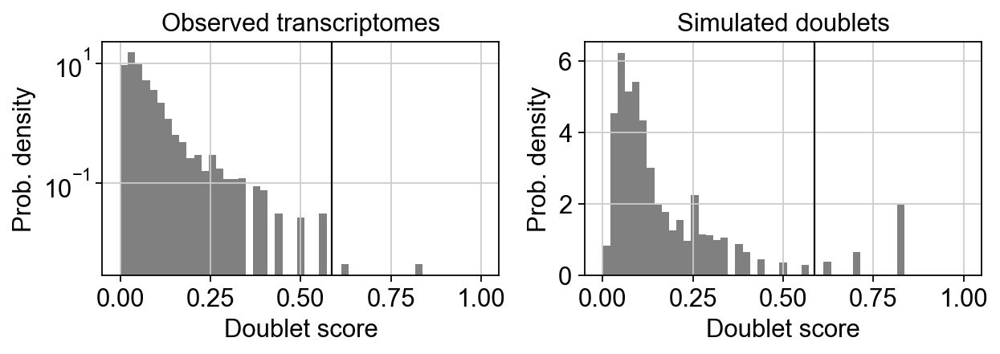

In [661]:
scrub.plot_histogram();

In [662]:
print('Running UMAP...')
scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.3))
print('Done.')

Running UMAP...
Done.


(array([6.084e+03, 1.378e+03, 2.120e+02, 4.100e+01, 1.200e+01, 2.000e+00,
        1.000e+00, 0.000e+00, 1.000e+00, 1.000e+00]),
 array([0.0055679287, 0.0859441987, 0.1663204687, 0.2466967388,
        0.3270730088, 0.4074492788, 0.4878255488, 0.5682018188,
        0.6485780888, 0.7289543588, 0.8093306288]),
 <BarContainer object of 10 artists>)

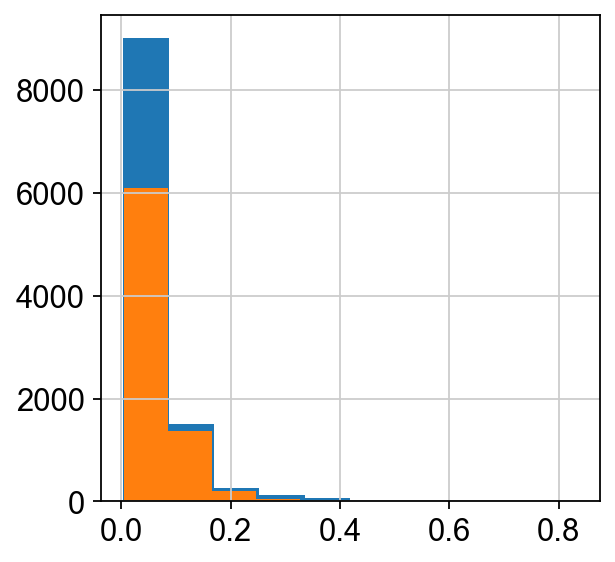

In [663]:
plt.hist(doublet_scores_Combo)
plt.hist(doublet_scores_Ctl)

In [664]:
adata = combodata.concatenate( ctldata)

adata.obs['doublet']

AAACCCAAGAAACTGT-1-0    0.033288
AAACCCAAGTCCCAGC-1-0    0.129054
AAACCCAAGTGCAAAT-1-0    0.035830
AAACCCAAGTTACGGG-1-0    0.124317
AAACCCACACCAATTG-1-0    0.064490
                          ...   
TTTGTTGAGCGGGTTA-1-1    0.021088
TTTGTTGCATTGACTG-1-1    0.047916
TTTGTTGTCAGACATC-1-1    0.028352
TTTGTTGTCGAACGCC-1-1    0.042561
TTTGTTGTCTATTTCG-1-1    0.214797
Name: doublet, Length: 18713, dtype: float64

normalizing counts per cell
    finished (0:00:00)


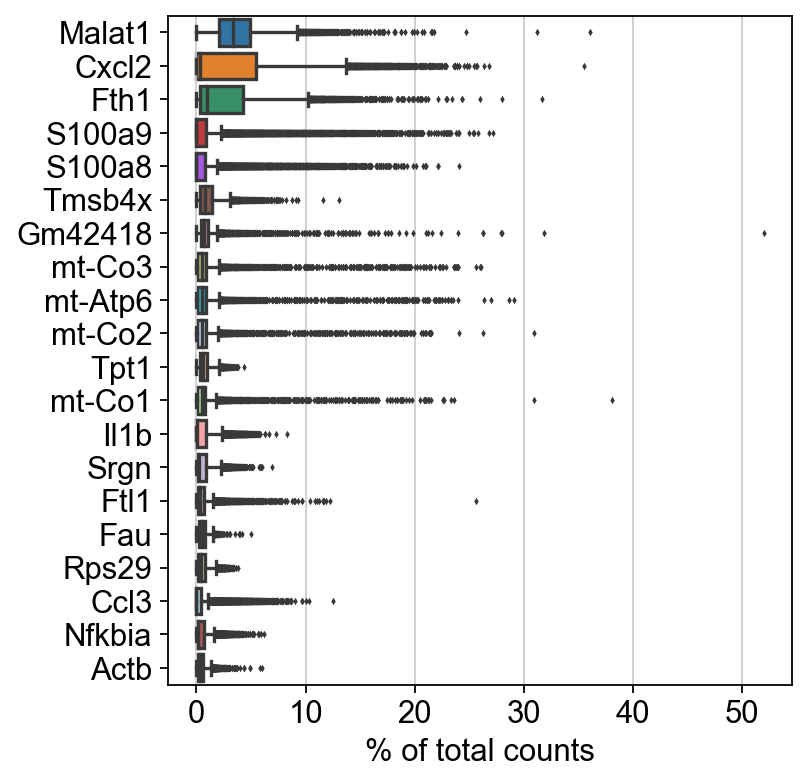

In [665]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [666]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 132 cells that have less than 200 genes expressed


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


filtered out 12259 genes that are detected in less than 3 cells


In [667]:
adata.var['mt'] = adata.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'treat' as categorical
... storing 'feature_types' as categorical
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical"

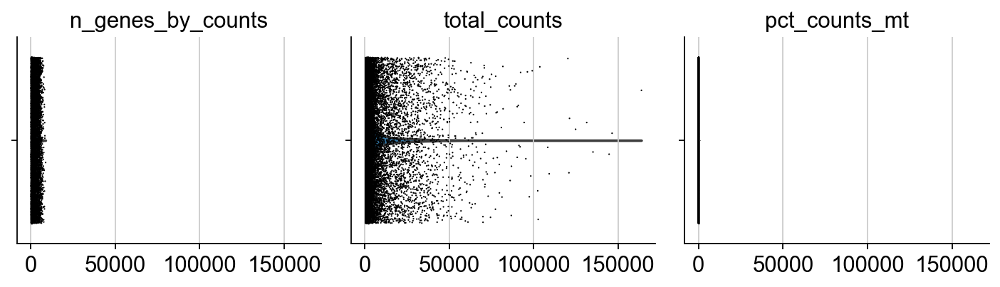

In [668]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


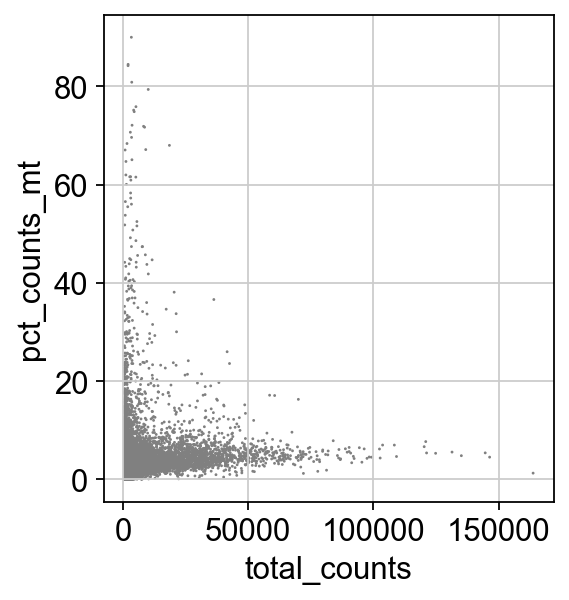

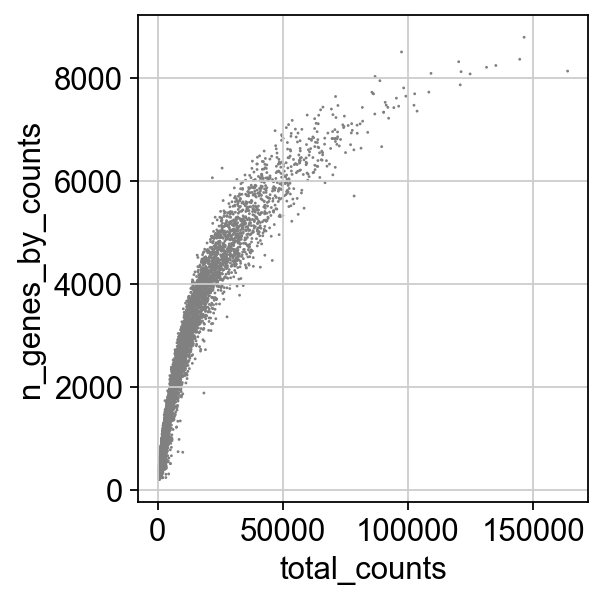

In [669]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [670]:
adata = adata[adata.obs.n_genes_by_counts < 8000, :]
adata = adata[adata.obs.pct_counts_mt < 20, :]
#Filter Doublets
#adata = adata[adata.obs['doublet']< 0.5]

sc.pp.filter_cells(adata, min_counts = 700)  #Needs this filter 
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = 80000)#Needs this filter 
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

filtered out 1450 cells that have less than 700 counts


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
Trying to set attribute `.obs` of view, copying.


Number of cells after min count filter: 16913
filtered out 27 cells that have more than 80000 counts
Number of cells after max count filter: 16886


In [671]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [672]:
sc.pp.log1p(adata)

In [673]:
#sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=10, min_disp=0.5) 
sc.pp.highly_variable_genes(adata, n_top_genes=4000) #best_practice_package
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 4000


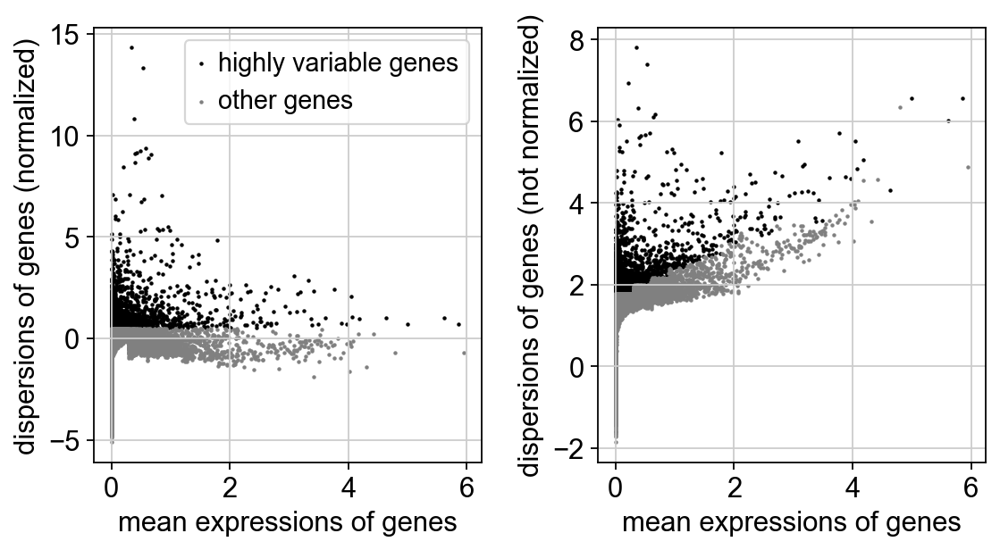

In [674]:
sc.pl.highly_variable_genes(adata)

In [675]:
adata.raw = adata
#raw layer is log transformed , normalized data; before scale & batch correction

In [676]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished (0:02:54)


In [677]:
sc.pp.scale(adata, max_value=10)
#sc.pp.scale(adata)
#Scale each gene to unit variance. Clip values exceeding standard deviation 10.

In [678]:
#sc.tl.pca(adata, use_highly_variable=True, svd_solver='arpack')
sc.tl.pca(adata,svd_solver='arpack')#Use high variable genes
sc.pp.neighbors(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


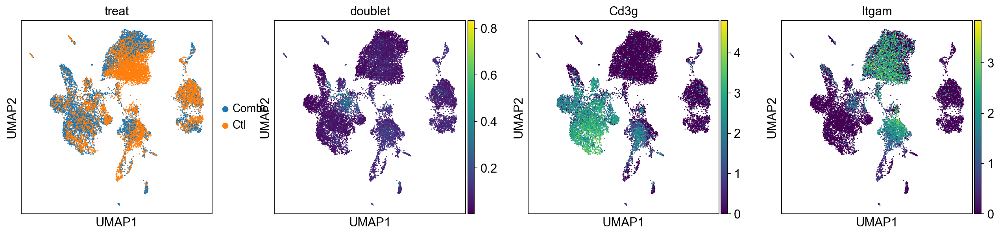

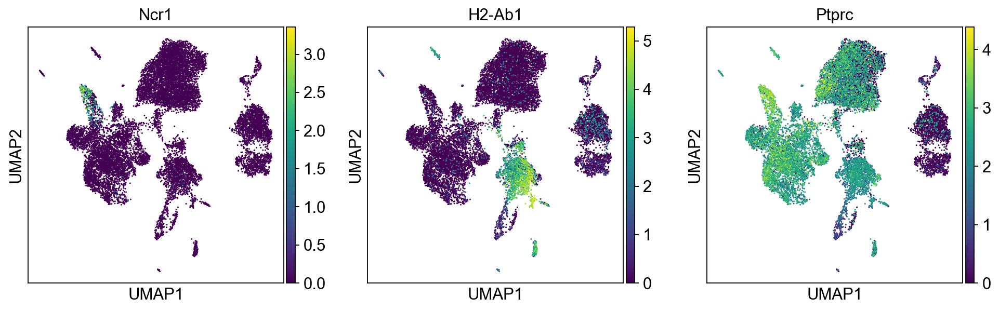

16886

In [679]:
#Before batch correction, regress out 
sc.tl.umap(adata)
sc.pl.umap(adata,color=['treat','doublet', 'Cd3g', 'Itgam'])
sc.pl.umap(adata,color=['Ncr1', 'H2-Ab1', 'Ptprc'])
adata.n_obs

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


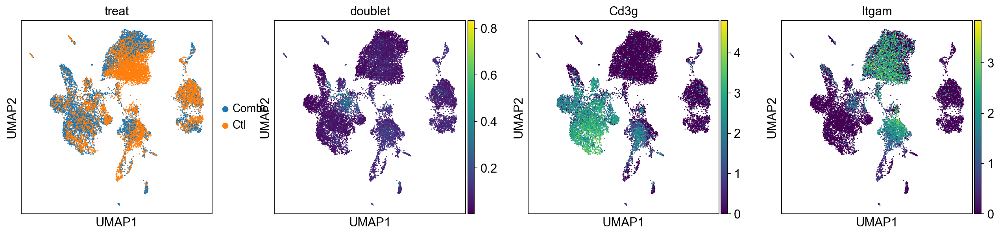

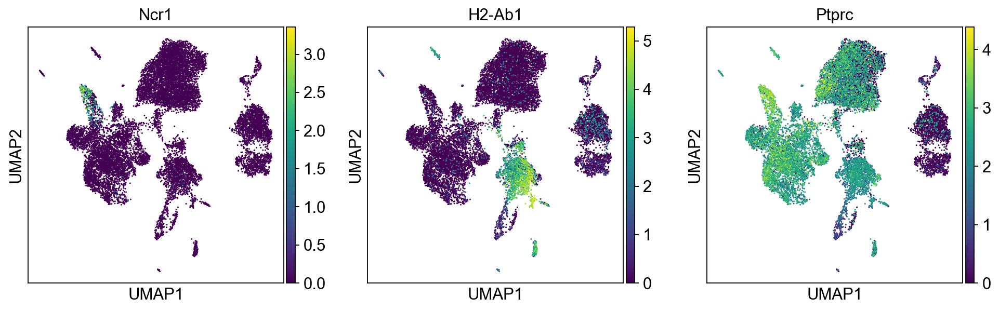

In [680]:
#No batch correction, regress_out
sc.tl.umap(adata)
sc.pl.umap(adata,color=['treat','doublet', 'Cd3g', 'Itgam'])
sc.pl.umap(adata,color=['Ncr1', 'H2-Ab1', 'Ptprc']) #Ptprc: CD45

In [681]:
#Batch Correction with bbknn
##sc.external.pp.bbknn(adata, batch_key='batch') 


computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE with a fix by D. DeTomaso
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:01:01)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


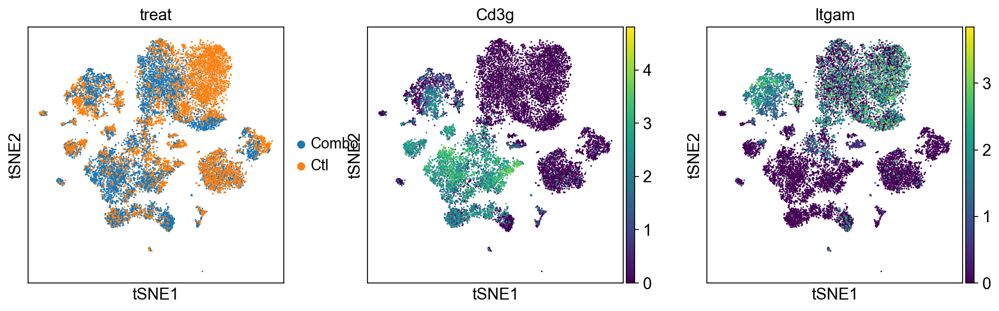

In [682]:
sc.tl.tsne(adata, n_jobs=12)  #Umap looks better
sc.pl.tsne(adata, color=['treat', 'Cd3g', 'Itgam'])

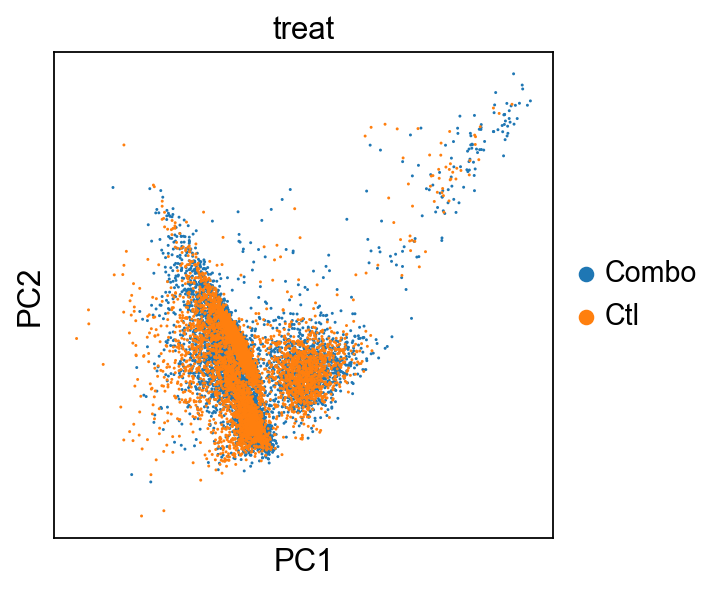

In [683]:
sc.pl.pca(adata, color='treat')

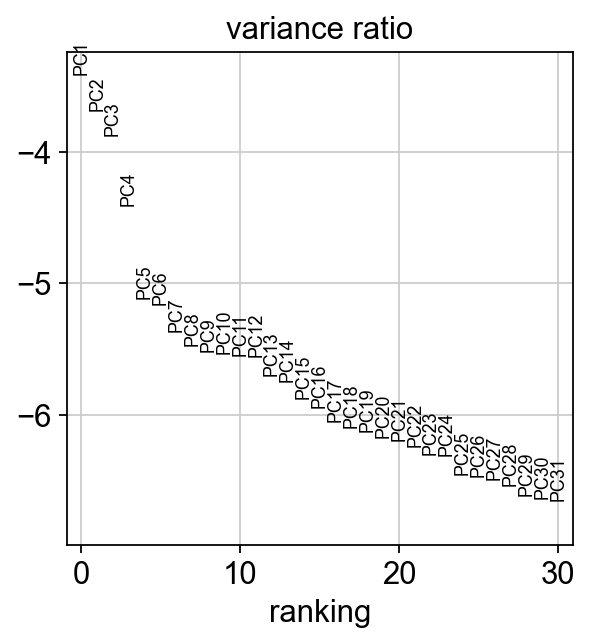

In [684]:
sc.pl.pca_variance_ratio(adata, log=True)

# Cell cycle scoring

Known sources of technical variation in the data have been investigated and corrected for (e.g. batch, count depth). A known source of biological variation that can explain the data is the cell cycle. Here, a gene list from Macosko et al., Cell 161 (2015) is used to score the cell cycle effect in the data and classify cells by cell cycle phase. The file can be found on the single-cell-tutorial github repository, or be taken from the supplementary material of the paper.
Please note, that s the gene list was generated for human HeLa cells, the gene names are put into lower case with a leading capital letter to map to the respective mouse genes. When adapting this script to your own data, this must be taken into account for data from species other than mouse.
We perform cell cycle scoring on the full batch-corrected data set in adata.

In [685]:
cc_genes_file = 'ref_genes.txt'
cc_genes_file = '../Macosko_cell_cycle_genes.txt'
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
#s_genes = cc_genes['CELL CYCLE: G1/S'].dropna()
#g2m_genes = cc_genes['CELL CYCLE: G2/M'].dropna()
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_mm = [gene.lower().capitalize() for gene in s_genes]
g2m_genes_mm = [gene.lower().capitalize() for gene in g2m_genes]

s_genes_mm_ens = adata.var_names[np.in1d(adata.var_names, s_genes_mm)]
g2m_genes_mm_ens = adata.var_names[np.in1d(adata.var_names, g2m_genes_mm)]

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes_mm_ens, g2m_genes=g2m_genes_mm_ens)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    1825 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    1925 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'phase' as categorical


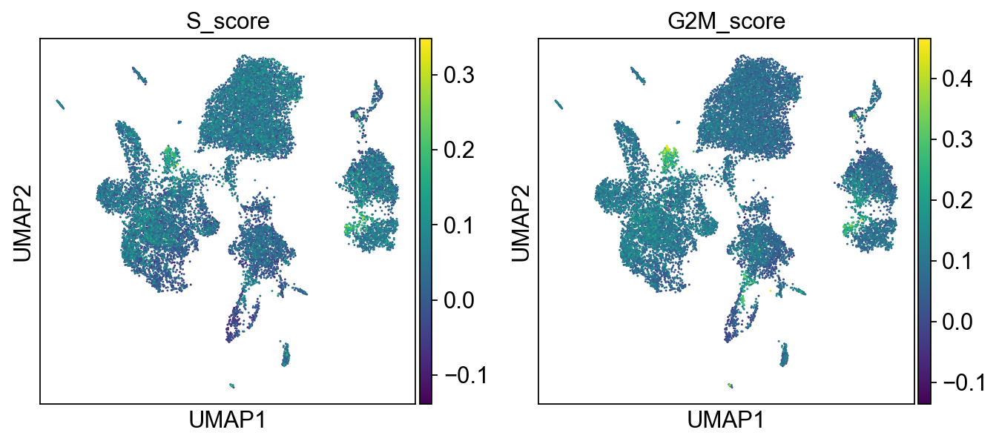

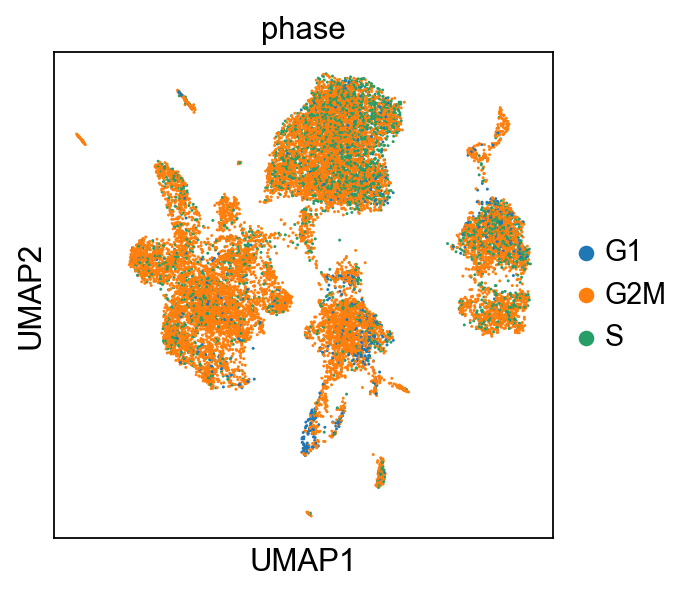

In [686]:
sc.pl.umap(adata, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata, color='phase', use_raw=False)

# Clustering

In [687]:
sc.tl.leiden(adata,resolution=0.2,key_added='louvain_r0.2' )

running Leiden clustering
    finished: found 13 clusters and added
    'louvain_r0.2', the cluster labels (adata.obs, categorical) (0:00:01)


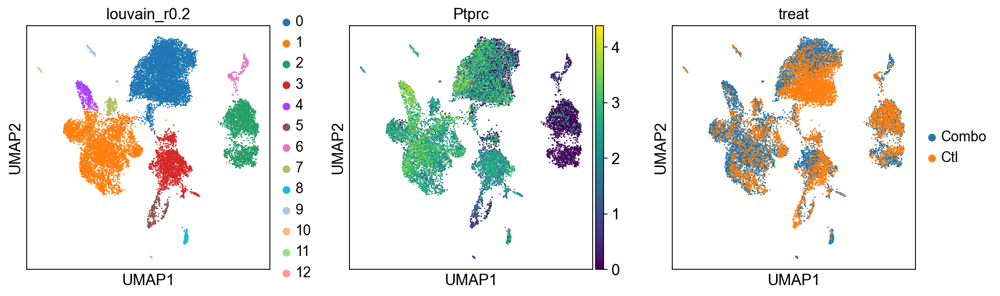

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an erro

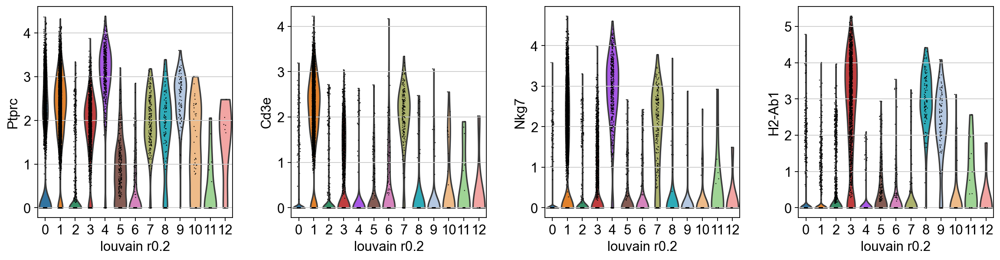

0     6240
1     5015
2     2377
3     1910
4      410
5      286
6      191
7      190
8      101
9       96
10      45
11      17
12       8
Name: louvain_r0.2, dtype: int64

In [688]:
sc.pl.umap(adata, color=['louvain_r0.2', 'Ptprc', 'treat']) # resolution=0.2
sc.pl.violin(adata, ['Ptprc', 'Cd3e', 'Nkg7','H2-Ab1'], groupby='louvain_r0.2')
adata.obs['louvain_r0.2'].value_counts() 

In [689]:
#Tmp data storage
adata.write('CD45+_adata_full.h5ad')

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [690]:
#Remove non-CD45+ cells, remove cluster 12 with less than 10 cells
adata=adata[(adata.obs['louvain_r0.2']!='2') & (adata.obs['louvain_r0.2']!='6') &(adata.obs['louvain_r0.2']!='5') &(adata.obs['louvain_r0.2']!='11') & (adata.obs['louvain_r0.2']!='12')]

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [691]:
#Combine two T cell population for big cluster & easy naming
old_to_new = {
    '0':'0',
    '1':'1',
    '3':'3',
    '4':'4',
    '7':'1',
    '8':'8',
    '9':'9',
    '10':'10'
}
adata.obs['louvain'] = (
    adata.obs['louvain_r0.2']
    .map(old_to_new)
    .astype('category')
)

Trying to set attribute `.obs` of view, copying.


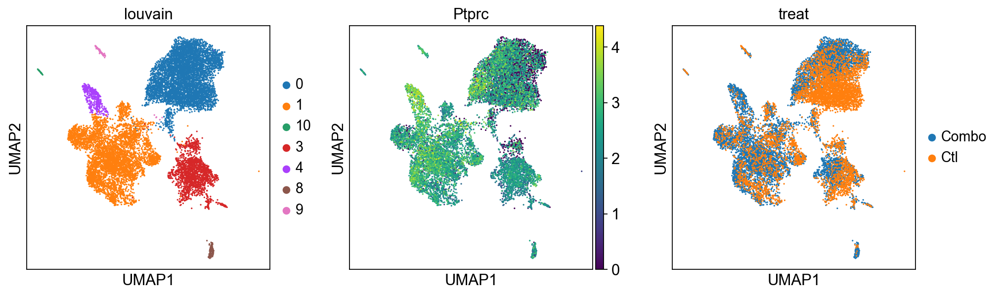

In [692]:
sc.pl.umap(adata, color=['louvain', 'Ptprc', 'treat']) # resolution=0.2

# Marker Gene and Cluster Annotation

To annotate the clusters we obtained, we find genes that are up-regulated in the cluster compared to all other clusters (marker genes). This differential expression test is performed by a Welch t-test with overestimated variance to be conservative.  The test is automatically performed on the `.raw` data set, which is uncorrected and contains all genes. All genes are taken into account, as any gene may be an informative marker.

In [693]:
sc.tl.rank_genes_groups(adata, groupby='louvain', method='t-test_overestim_var',key_added='rank_genes_r0.2')
#sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
#this one look good

ranking genes
    finished: added to `.uns['rank_genes_r0.2']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


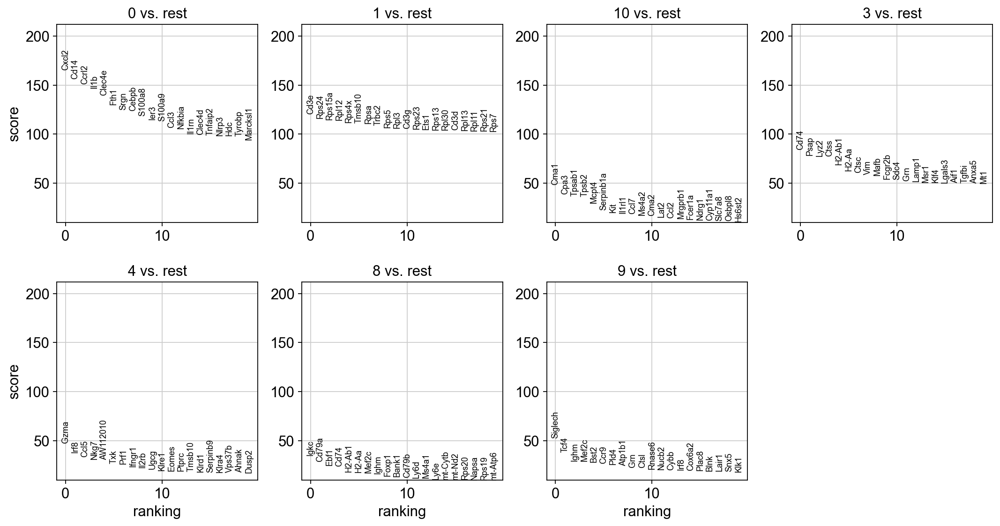

In [694]:
sc.pl.rank_genes_groups(adata, key='rank_genes_r0.2')

In [695]:
adata.uns['rank_genes_r0.2']['names']

rec.array([('Cxcl2', 'Cd3e', 'Cma1', 'Cd74', 'Gzma', 'Igkc', 'Siglech'),
           ('Cd14', 'Rps24', 'Cpa3', 'Psap', 'Irf8', 'Cd79a', 'Tcf4'),
           ('Ccrl2', 'Rps15a', 'Tpsab1', 'Lyz2', 'Ccl5', 'Ebf1', 'Ighm'),
           ...,
           ('Tmsb10', 'Cxcl2', 'Btg2', 'Pnrc1', 'Fth1', 'Fxyd5', 'Slfn2'),
           ('Rps24', 'Cd14', 'AY036118', 'Samsn1', 'Cxcl2', 'Cd14', 'Cd52'),
           ('Rps4x', 'Tyrobp', 'Gm42418', 'Malat1', 'Cd14', 'Nfkbia', 'Junb')],
          dtype=[('0', 'O'), ('1', 'O'), ('10', 'O'), ('3', 'O'), ('4', 'O'), ('8', 'O'), ('9', 'O')])

In [696]:
reffile = 'ref_genes.txt'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
marker_genes = refdict
#hand-picked marker gene set
marker_genes['mB cells']=['Cd19','Cd20']
marker_genes['mT cells']=['Cd3d','Cd3e','Cd3g']
marker_genes['mNK cells']=['Ncr1','Klrb1b']
marker_genes['mM']=['Itgam','Csf1r']
marker_genes['mNeu']=['Itgam','Csf3r']
marker_genes['mpDC']=['Siglech','Klk1','Ccr9','Tcf4','Bst2'] #Ramin
marker_genes['mcDC']=['Flt3','Dpp4','Zbtb46'] #Ramin

In [697]:
reffile = 'ref_genes_Zhang'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
marker_genes_Zhang = refdict
marker_genes_Zhang['Th']=['Tbx21','Csf1','Gata4','Ifitm2']
#marker_genes_Zhang['Th1']=['Tbx21','Ifng','Csf1','Ifngr2','Il21r','Il12rb2','Il18r1']
#marker_genes_Zhang['Th2']=['Gata3','Il4','Fcgrf','Ifitm2']
#marker_genes_Zhang['Th17']=['Il17f','Il17a','Il21','Il2','Ptgfm']

cell_annotation = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.2',top_n_markers=200)
cell_annotation_Zhang = sc.tl.marker_gene_overlap(adata,marker_genes_Zhang, key='rank_genes_r0.2',method='overlap_coef',top_n_markers=200)

cell_annotation_Zhang

,0,1,10,3,4,8,9
Naive Markers,0.25,0.00,0.000,0.00,0.000,0.25,0.25
Inhibitory Receptors,0.00,0.20,0.000,0.00,0.000,0.00,0.00
Cytokines and effector molecules,0.00,0.00,0.000,0.00,0.500,0.00,0.00
Co-stimulatory molecules,0.00,0.50,0.000,0.00,0.000,0.00,0.00
Transcription factos,0.00,0.25,0.125,0.25,0.125,0.00,0.00
Treg markers,0.00,0.00,0.000,0.00,0.000,0.00,0.00
Th,0.50,0.00,0.000,0.00,0.000,0.00,0.00


<AxesSubplot:>

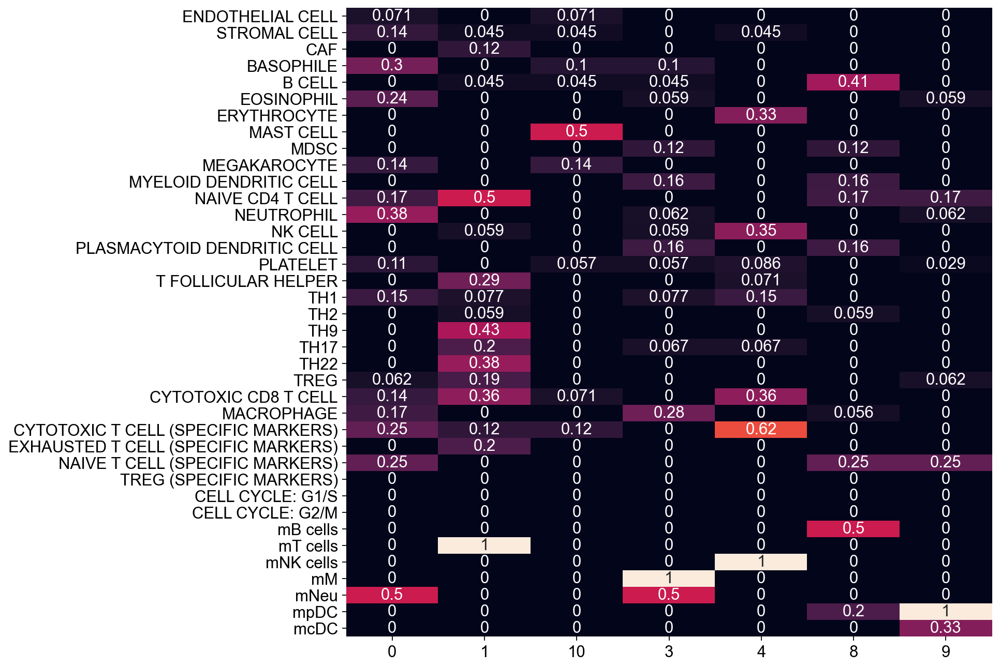

In [698]:
plt.rcParams["figure.figsize"] = (10,10)
cell_annotation_norm = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.2', normalize='reference',top_n_markers=200)
cell_annotation_norm_Zhang = sc.tl.marker_gene_overlap(adata, marker_genes_Zhang, key='rank_genes_r0.2', normalize='reference',top_n_markers=200)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sb.heatmap(cell_annotation_norm_Zhang, cbar=False, annot=True)

In [699]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


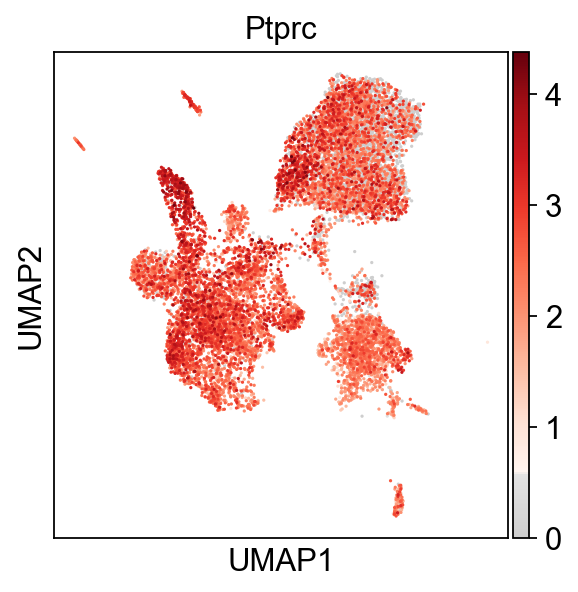

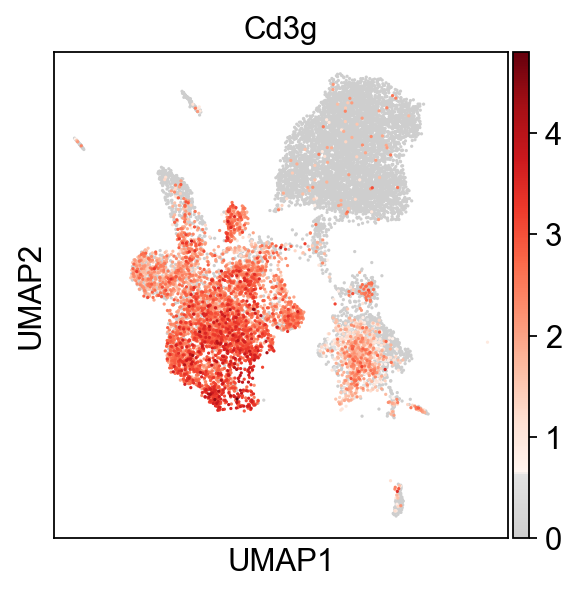

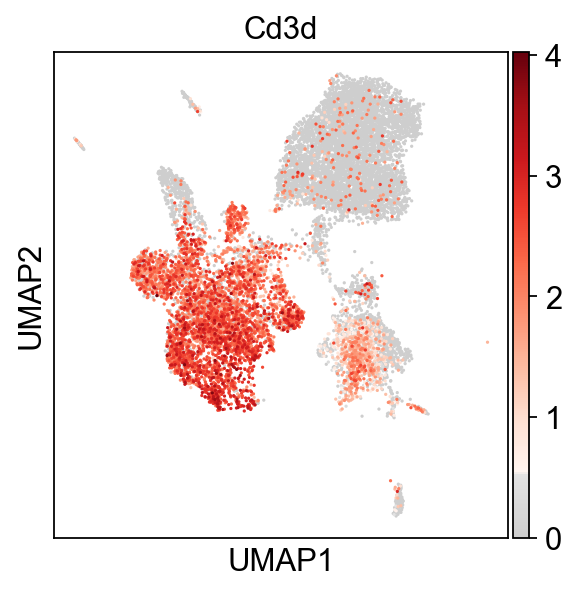

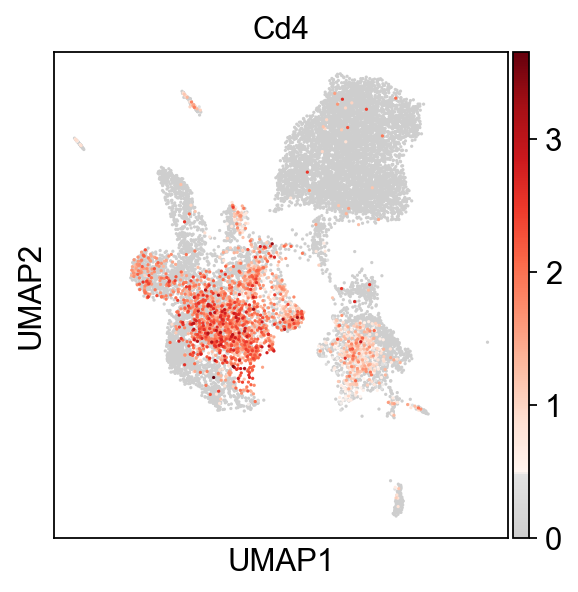

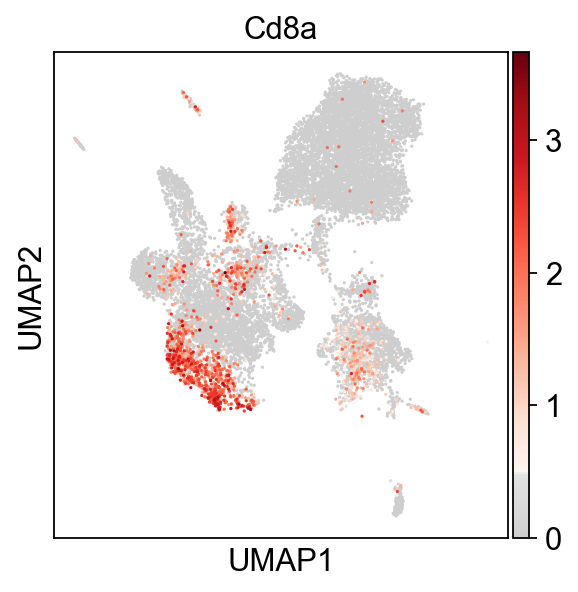

...

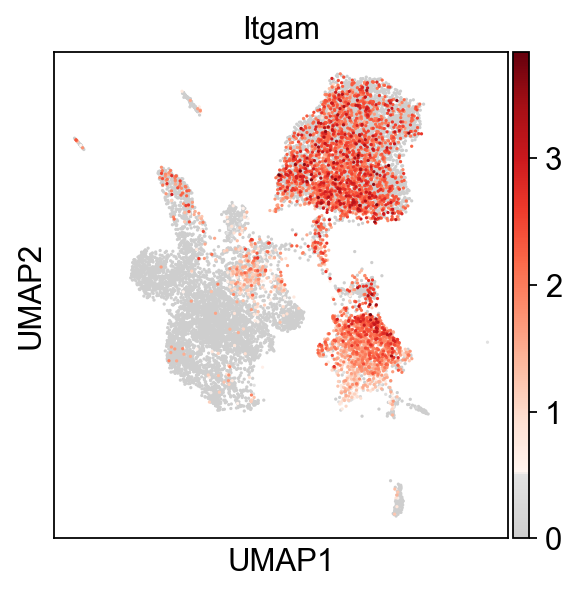

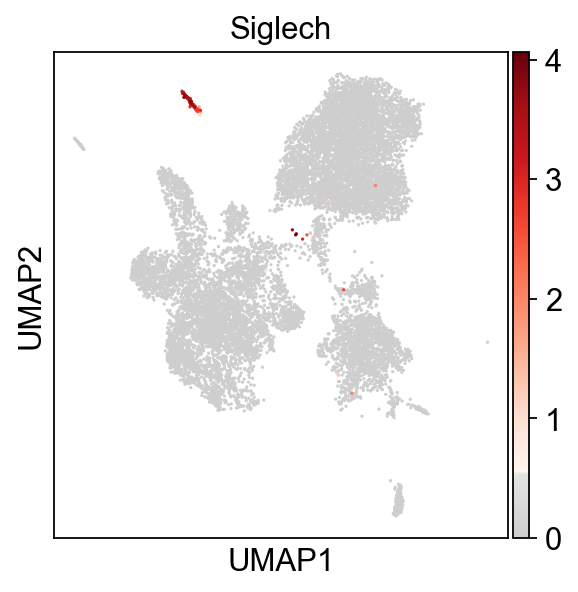

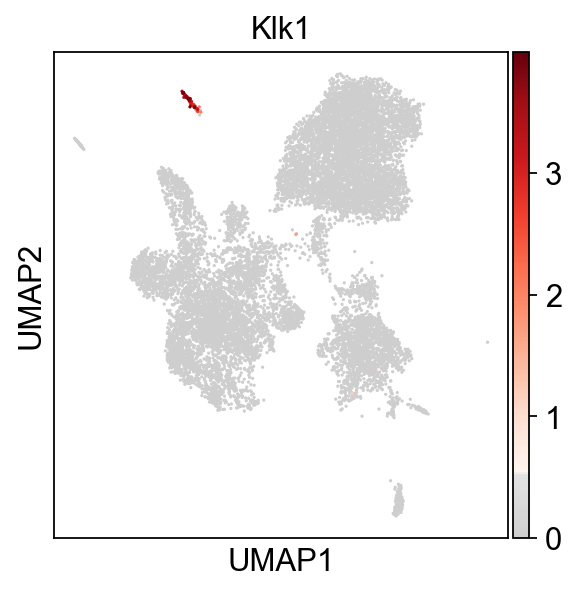

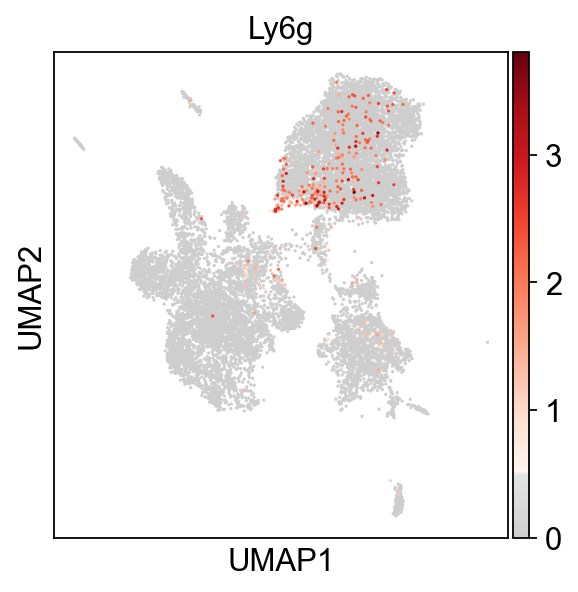

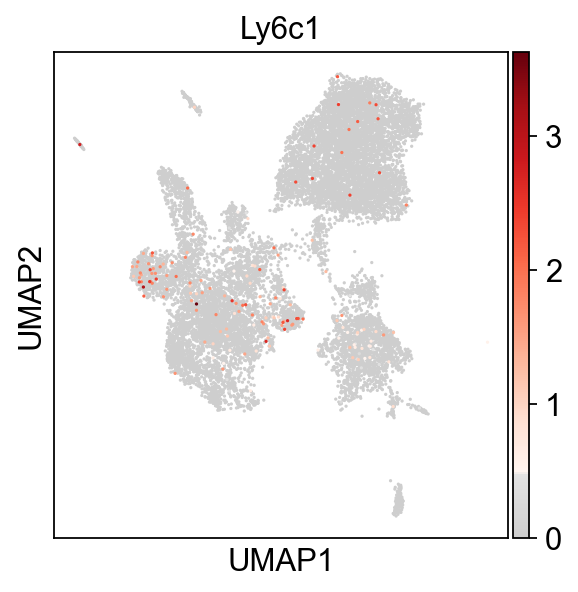

In [700]:
#Plot signiture marker gene
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(adata, color='Ptprc', use_raw=True, color_map=mymap) #CD45
sc.pl.umap(adata, color='Cd3g', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Cd3d', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Cd4', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Cd8a', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='H2-Ab1', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Ncr1', use_raw=True, color_map=mymap) #macrophage
sc.pl.umap(adata, color='Cd19', use_raw=True, color_map=mymap) #APC
sc.pl.umap(adata, color='Cd14', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Csf1r', use_raw=True, color_map=mymap) #epithelial
sc.pl.umap(adata, color='Csf3r', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Itgam', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Siglech', use_raw=True, color_map=mymap) #pDC
sc.pl.umap(adata, color='Klk1', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Ly6g', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Ly6c1', use_raw=True, color_map=mymap)

In [701]:
adata.rename_categories('louvain', ['Neutrophils', 'T cells','Mast cells','MC/Macro/cDC', 'NK cells','pDC','B cells',])

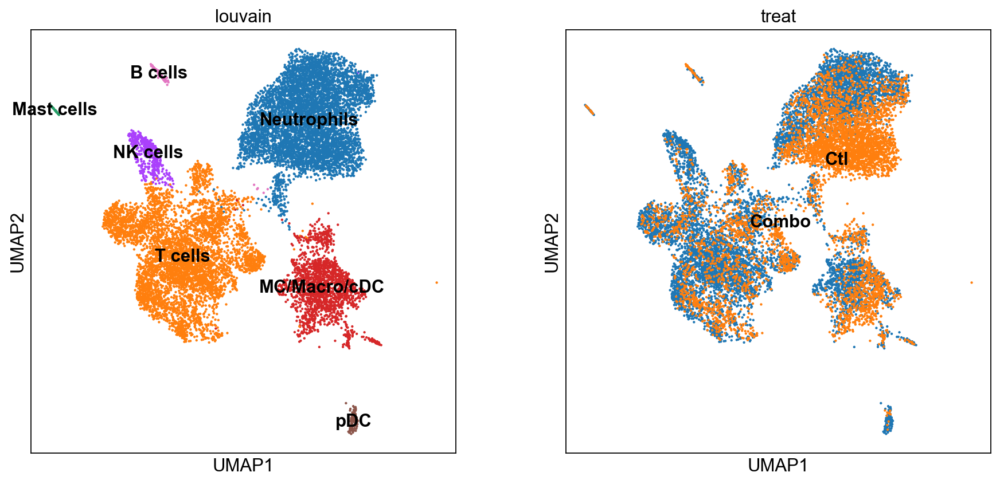

In [702]:
plt.rcParams["figure.figsize"] = (6,6)
sc.pl.umap(adata, color=['louvain','treat'], size=15, legend_loc='on data')

In [703]:
adata[adata.obs['treat']=='Combo'].obs['louvain'].value_counts()   

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


T cells         3788
Neutrophils     2986
MC/Macro/cDC    1115
NK cells         379
pDC               90
B cells           55
Mast cells        31
Name: louvain, dtype: int64

In [704]:
adata[adata.obs['treat']=='Ctl'].obs['louvain'].value_counts()   

Neutrophils     3254
T cells         1417
MC/Macro/cDC     795
B cells           41
NK cells          31
Mast cells        14
pDC               11
Name: louvain, dtype: int64

In [705]:
#Tmp data storage
adata.write('CD45+_adata_clusters.h5ad') #After filtering CD45- clusters & naming

# Subclustering

# Neutrophil 

In [706]:
Neu = adata[adata.obs['louvain']== 'Neutrophils']

In [707]:
sc.tl.leiden(Neu,resolution=0.5,key_added='louvain_r0.5' )

running Leiden clustering


Trying to set attribute `.obs` of view, copying.


    finished: found 6 clusters and added
    'louvain_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)


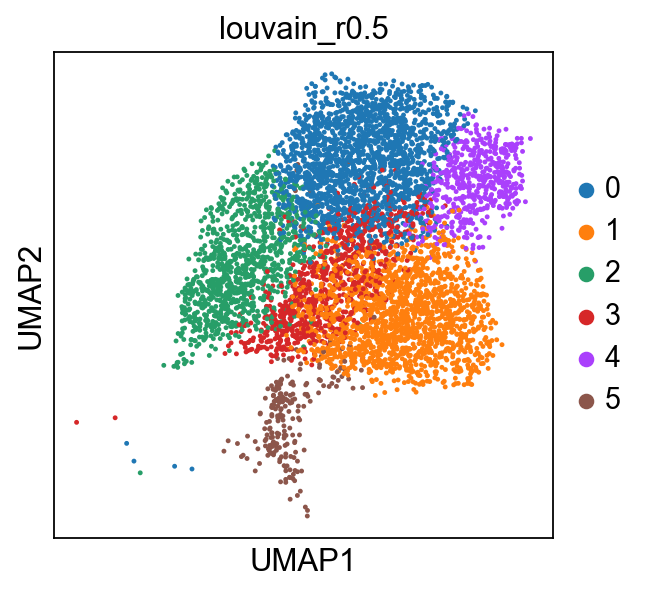

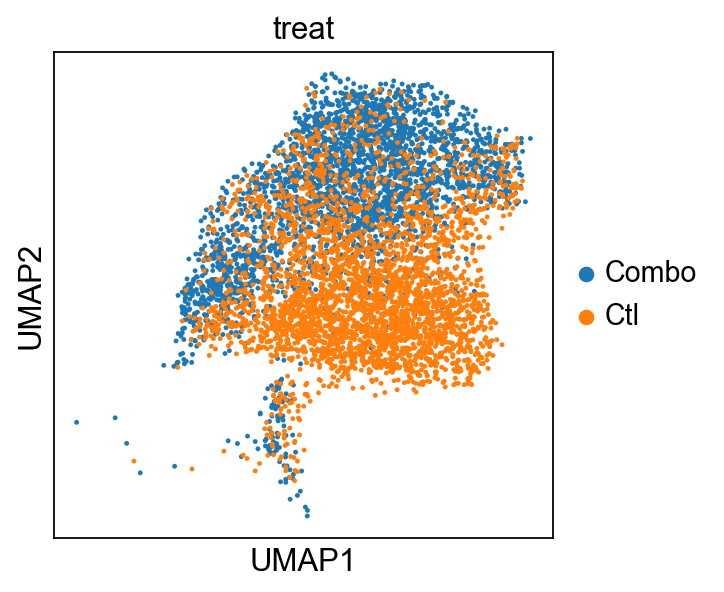

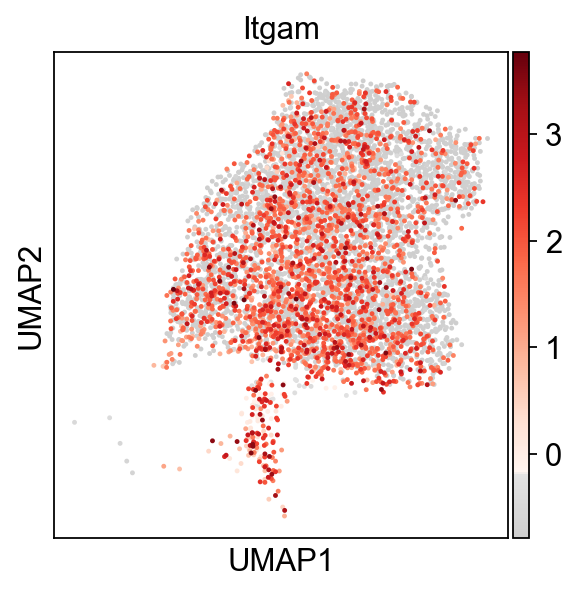

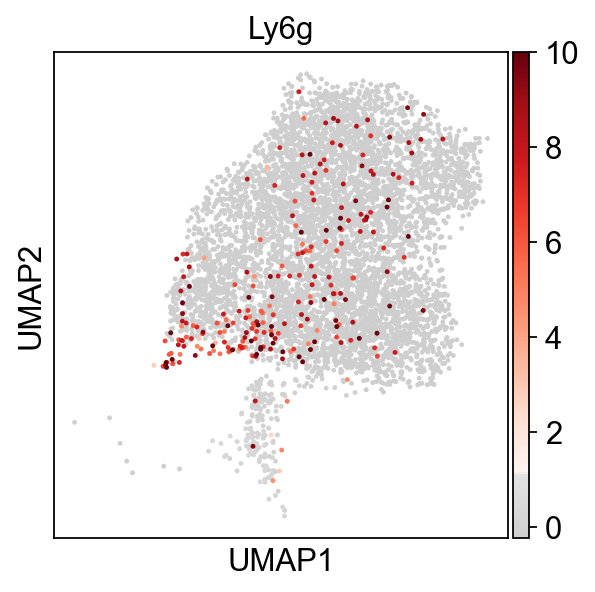

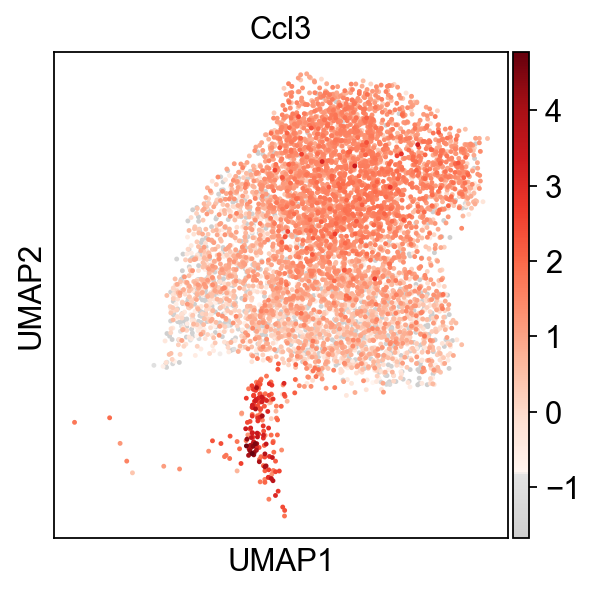

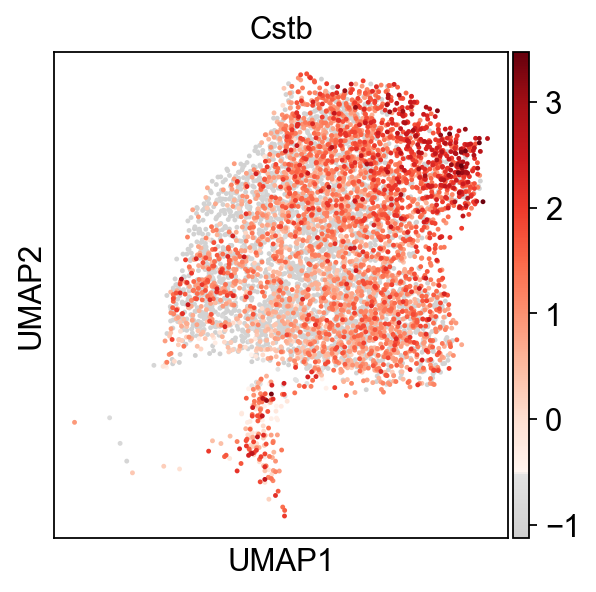

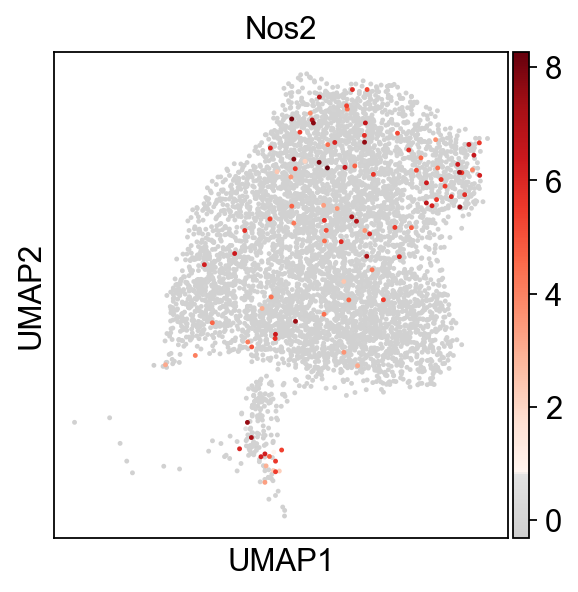

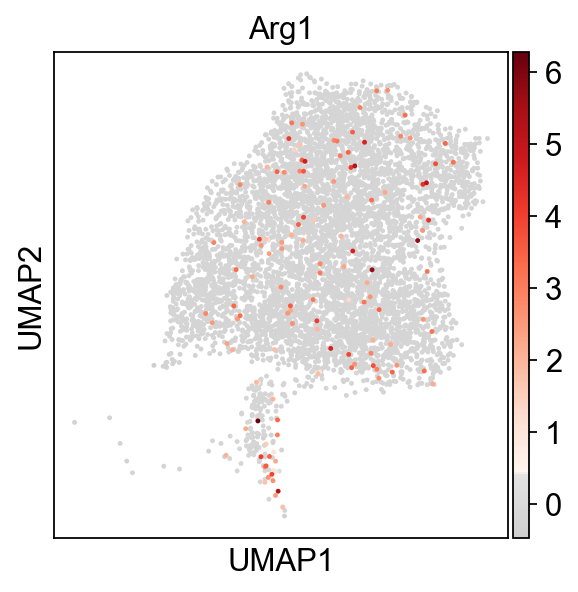

In [708]:
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(Neu, color='louvain_r0.5', palette=sc.pl.palettes.default_20)
sc.pl.umap(Neu, color='treat')
sc.pl.umap(Neu, color='Itgam', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Ly6g', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Ccl3', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Cstb', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Nos2', use_raw=False, color_map=mymap)  #MDSC marker, not significant
sc.pl.umap(Neu, color='Arg1', use_raw=False, color_map=mymap) 

In [709]:
Neu[Neu.obs['treat']=='Combo'].obs['louvain_r0.5'].value_counts()   

0    1549
2     670
4     320
3     252
5     101
1      94
Name: louvain_r0.5, dtype: int64

In [710]:
Neu[Neu.obs['treat']=='Ctl'].obs['louvain_r0.5'].value_counts()   

1    1591
3     580
0     392
2     361
4     218
5     112
Name: louvain_r0.5, dtype: int64

ranking genes
    finished: added to `.uns['Neutrophil_Rankgenes_0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


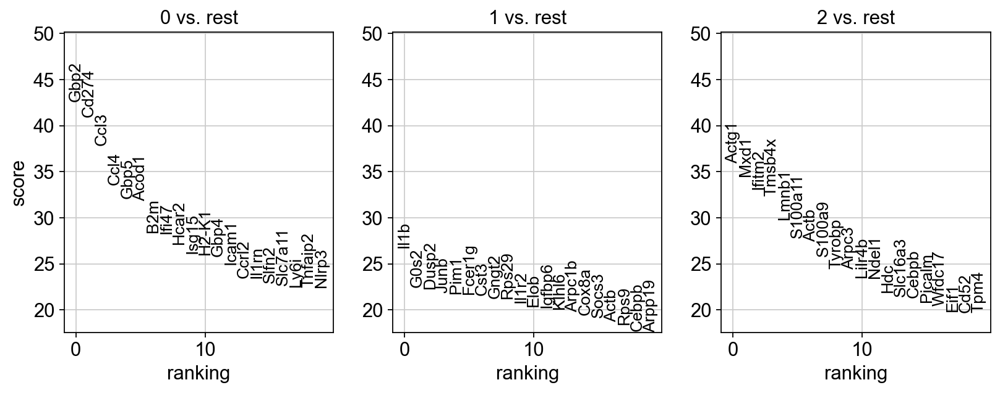

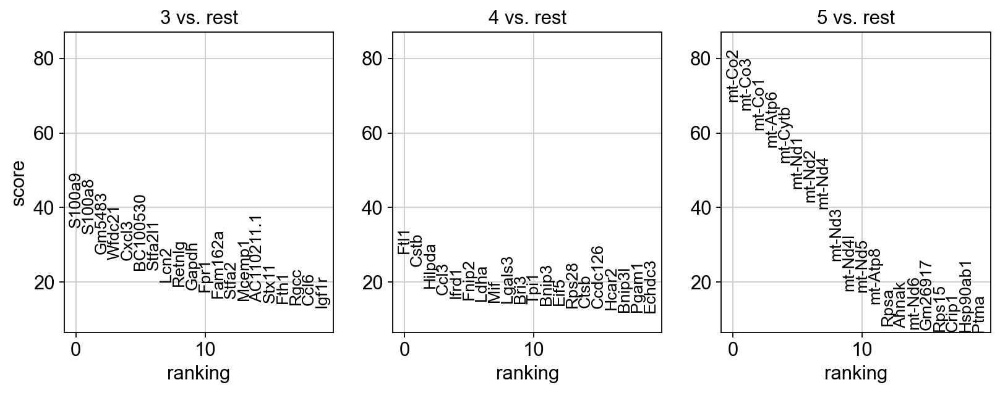

In [711]:
plt.rcParams["figure.figsize"] = (4,4)
#sc.tl.dendrogram(Neu,groupby='louvain_r0.5')
sc.tl.rank_genes_groups(Neu, groupby='louvain_r0.5',key_added='Neutrophil_Rankgenes_0.5',n_genes=200)
sc.pl.rank_genes_groups(Neu, key='Neutrophil_Rankgenes_0.5', groups=['0','1','2'], fontsize=12)
sc.pl.rank_genes_groups(Neu, key='Neutrophil_Rankgenes_0.5', groups=['3','4','5'], fontsize=12)
#sc.pl.rank_genes_groups_heatmap(Neu, key='Neutrophil_Rankgenes', groups=['0','1','2','3','4','5'])
#sc.pl.rank_genes_groups_heatmap(Neu,n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r0.5']`
categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 2, etc.


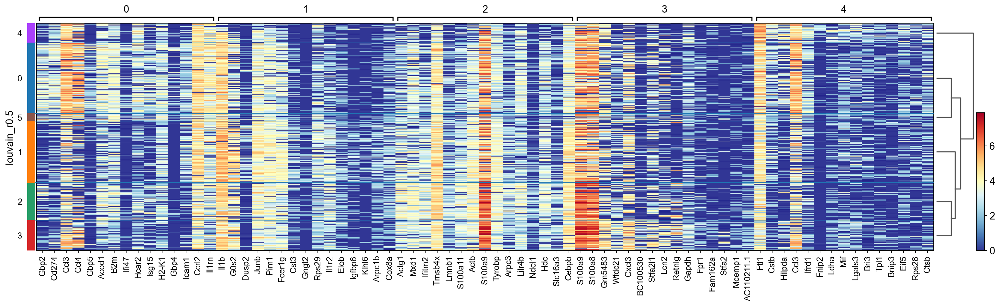

In [712]:

sc.pl.rank_genes_groups_heatmap(Neu, key='Neutrophil_Rankgenes_0.5', groups=['0','1','2','3','4'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

<AxesSubplot:>

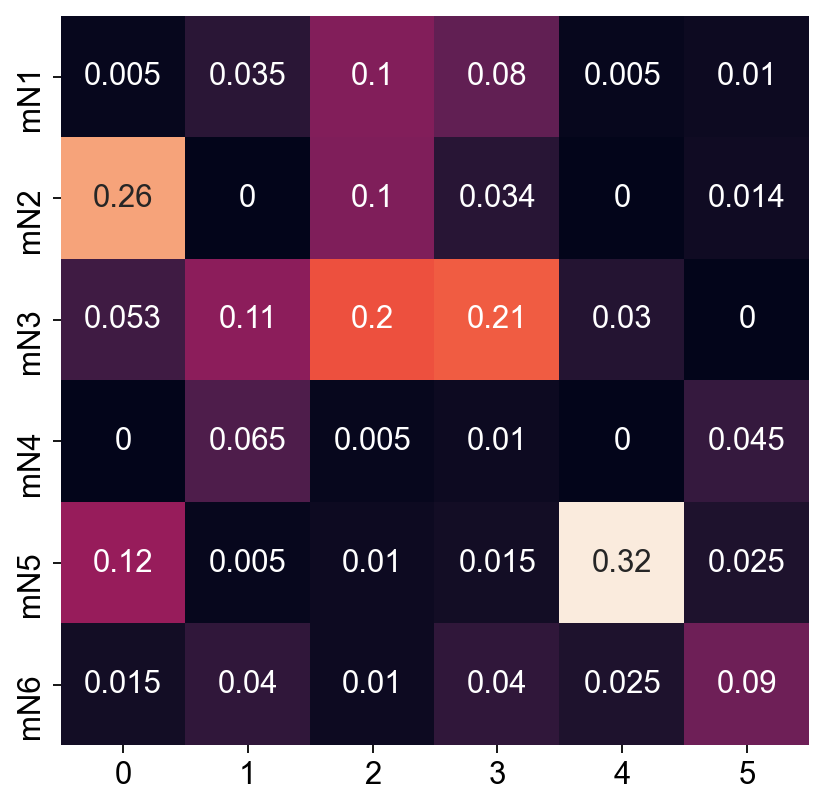

In [713]:
reffile = 'ref_gene_N_Immunity'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
marker_genes_N = refdict

#cell_annotation = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.2',top_n_markers=200)
#cell_annotation = sc.tl.marker_gene_overlap(Neu,marker_genes_N, key='Neutrophil_Rankgenes',method='overlap_coef',top_n_markers=200)
plt.rcParams["figure.figsize"] = (6,6)
cell_annotation_norm = sc.tl.marker_gene_overlap(Neu, marker_genes_N, key='Neutrophil_Rankgenes_0.5', normalize='reference',top_n_markers=200)
#cell_annotation_norm_Zhang = sc.tl.marker_gene_overlap(adata, marker_genes_Zhang, key='rank_genes_r0.2', normalize='reference',top_n_markers=200)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['louvain_r0.5']"]`


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


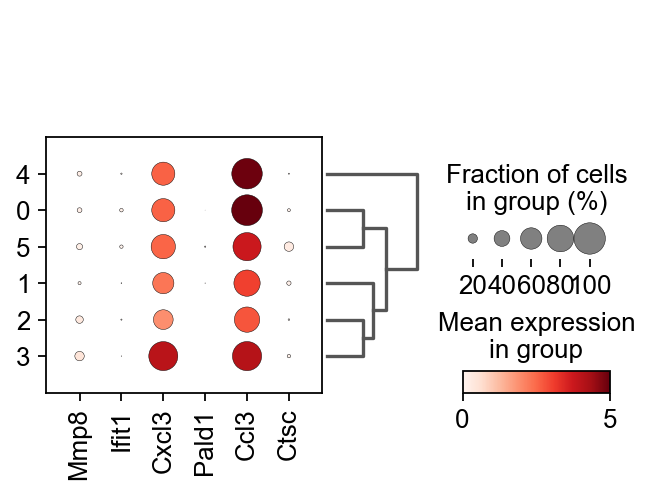

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


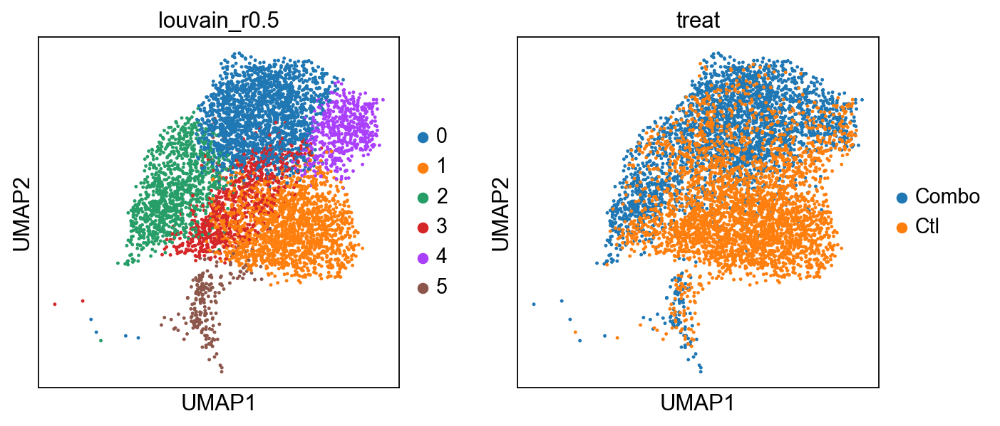

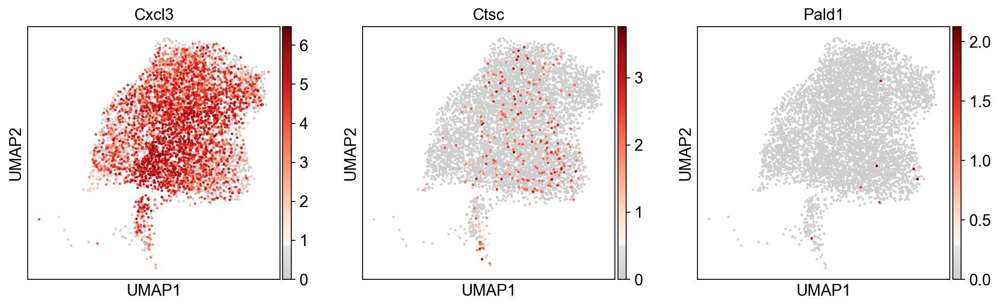

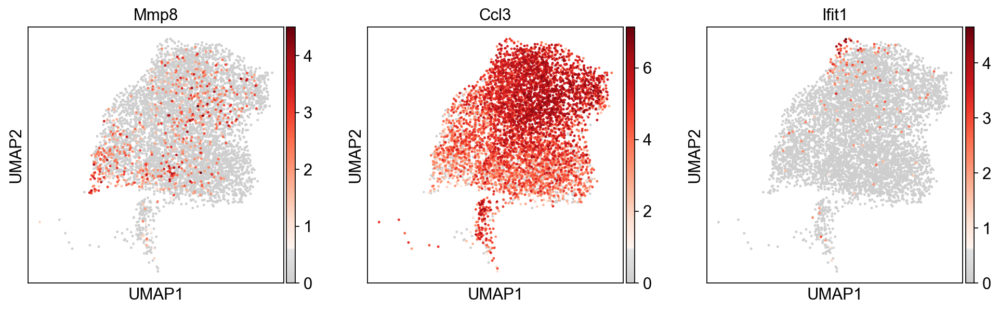

In [714]:
ImmunityMarker=['Mmp8','Ifit1','Cxcl3','Pald1','Ccl3','Ctsc']
sc.pl.dotplot(Neu, ImmunityMarker, groupby='louvain_r0.5', dendrogram=True)
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(Neu,color=['louvain_r0.5','treat'])
stem_genes = Neu.var_names[np.in1d(Neu.var_names, ImmunityMarker)] 
sc.pl.umap(Neu, color=stem_genes[0:3], title=stem_genes[0:3], color_map=mymap)
sc.pl.umap(Neu, color=stem_genes[3:], title=stem_genes[3:], color_map=mymap)

In [715]:
def marker_gene_expression(anndata, marker_dict, partition_key,gene_symbol_key=None, ):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    #for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
    for gene in marker_dict:
        ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
        if np.sum(ens_idx) == 0:
            continue
        else:
            z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
            ens_idx = ens_idx[0]

        clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
        clust_marker_exp.append(partition_key)
        marker_exp.loc[i] = clust_marker_exp
        marker_names.append(gene)
        i+=1

    #Replace the rownames with informative gene symbols
    marker_exp.index = marker_names

    return(marker_exp)

#meanexp = marker_gene_expression(adata,adata.var.index)

#meanexp.to_csv("CD45+ClustersGeneExpression.csv")

Compare with Immunity Paper
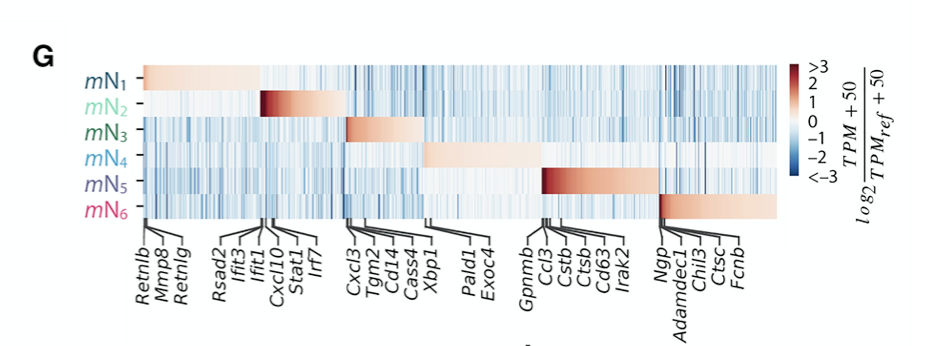
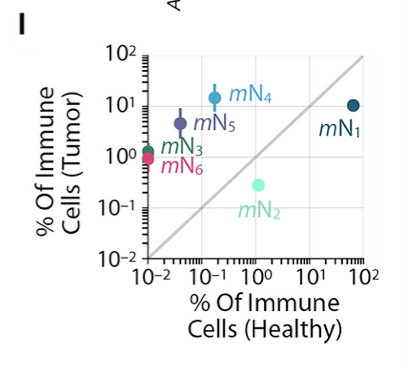

In [716]:
markerlist_N=[]
for key in marker_genes_N:
    markerlist_N.extend(marker_genes_N[key])
markerlist_N
meanexp_N = marker_gene_expression(Neu,markerlist_N,'louvain_r0.5')

In [717]:
#meanexp_N[0:5]
tmpdf = meanexp_N.filter(items=list(meanexp_N)[:6]).transpose()
tmpdf

,Chsy1,Retnlb,Mmp8,Scnn1a,Dhrs7,Retnlg,Rdh12,Klf2,Emp3,E2f2,...,Rab10,Rps15,Zfhx3,Ddx10,Psmd6,Naca,Cc2d1a,Anxa7,Rps18,Abracl
0,-0.045478,-0.044404,-0.078683,0.014942,-0.142461,-0.308687,-0.045708,0.039369,0.021017,-0.028064,...,0.024627,-0.048530,-0.057816,0.018611,0.000611,-0.029307,0.005456,0.027924,0.032586,-0.035199
1,0.041524,-0.030648,-0.190100,-0.059146,0.019837,-0.283676,-0.056846,0.037299,0.096866,0.076620,...,0.034483,0.293065,0.089310,0.078464,0.074036,0.239445,0.022782,0.066620,0.224602,0.277972
2,0.058333,0.004843,0.159072,0.110582,0.181860,0.503086,0.111795,-0.160990,0.034181,0.045506,...,-0.002909,-0.111516,0.000740,-0.010862,0.063522,-0.146308,0.009326,-0.090493,-0.007933,-0.161447
3,0.026954,0.165604,0.330291,-0.023938,0.051626,0.794307,0.126549,-0.059493,-0.031864,-0.055818,...,-0.009923,-0.056054,0.004509,-0.025586,0.018078,-0.097453,-0.059755,-0.020342,0.019725,-0.154490
4,-0.079898,-0.056517,-0.023476,-0.075823,-0.050016,-0.299091,-0.047618,0.091165,-0.015267,-0.049526,...,-0.017944,0.244017,-0.077101,0.062808,0.034352,0.470054,-0.021626,-0.027941,0.153079,-0.054970
5,-0.099886,0.119529,0.220035,0.081498,0.185678,0.274742,-0.048948,0.127549,-0.960231,-0.227529,...,-0.399037,-1.733742,-0.006108,-0.796437,-1.056097,-1.725560,0.012942,-0.193424,-2.499026,-0.354461


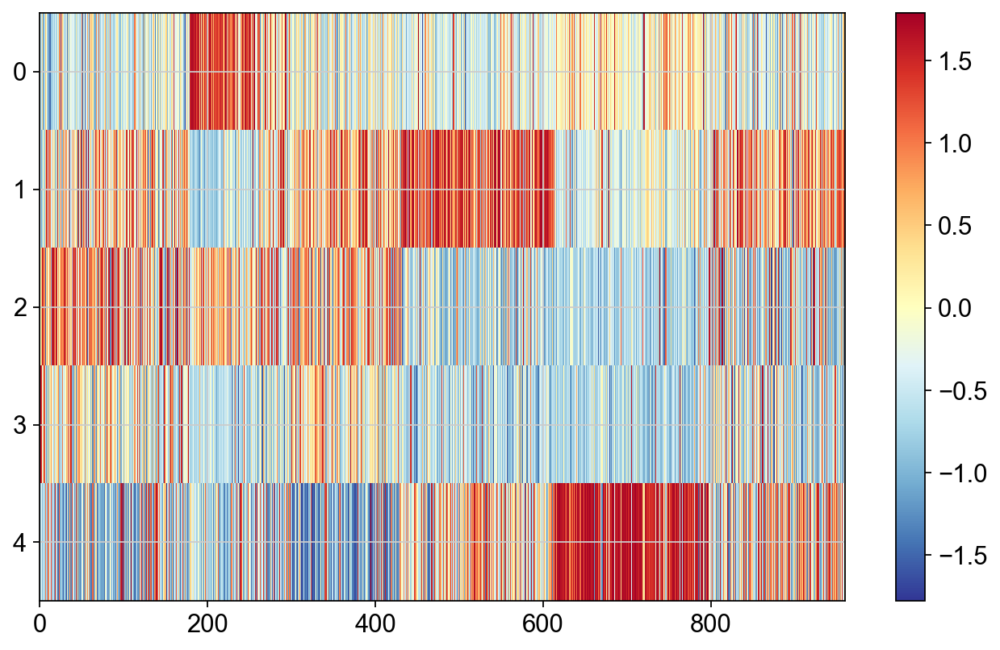

In [718]:
plt.rcParams["figure.figsize"] = (10,6)
tmpdf = meanexp_N.filter(items=list(meanexp_N)[:5]).transpose()
df_norm_col=(tmpdf-tmpdf.mean())/tmpdf.std()
im=plt.imshow(df_norm_col, cmap='RdYlBu_r',aspect='auto',interpolation='none')
plt.imshow(df_norm_col, cmap='RdYlBu_r',aspect='auto',interpolation='none')
plt.colorbar(im)
plt.grid(False)
#plt.imshow(df_norm_col,aspect='auto',interpolation='none')
#plt.savefig('N_tmp.png')
#plt.yticks(np.arange(len(list(meanexp_N)[:6])),list(meanexp_N)[:6])


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


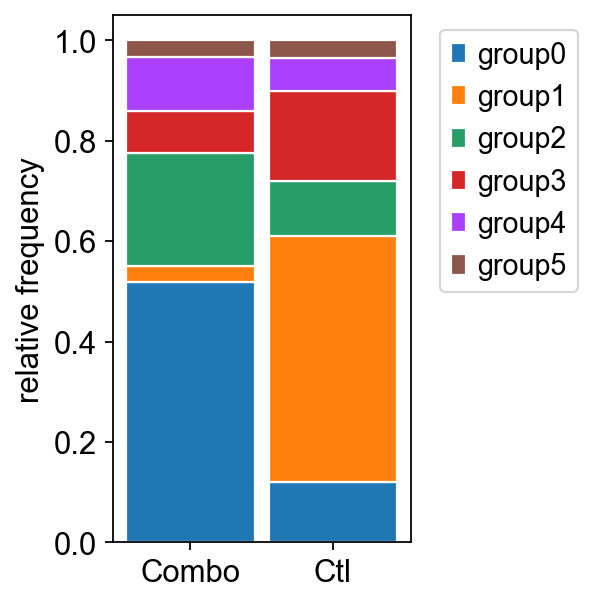

In [719]:
combocount = Neu[Neu.obs['treat']=='Combo'].obs['louvain_r0.5'].value_counts()
ctlcount = Neu[Neu.obs['treat']=='Ctl'].obs['louvain_r0.5'].value_counts()

#combocount.index[1]
plt.rcParams["figure.figsize"] = (4,4)
r=[0,1]
bottom = [0,0]
combofreq = {}
ctlfreq = {}
for i in range(len(combocount)):
    combofreq[combocount.index[i]] = combocount[i]/sum(combocount)
    ctlfreq[ctlcount.index[i]] = ctlcount[i]/sum(ctlcount)
handlelist = []
for i in range(len(combocount)):
    height = [combofreq[str(i)],ctlfreq[str(i)]]
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
plt.xticks(r,['Combo','Ctl'])
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

In [720]:
namelist=Neu.uns['Neutrophil_Rankgenes_0.5']['names']
outfile = open('Rank_genes_NeuOnly_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in namelist:
    outfile.write('\t'.join(item)+'\n')
outfile.close()

loglist=Neu.uns['Neutrophil_Rankgenes_0.5']['logfoldchanges']
outfile = open('Rank_genes_foldchange_NeuOnly_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

pvals_list=Neu.uns['Neutrophil_Rankgenes_0.5']['pvals_adj']
outfile = open('Rank_genes_pvals_adj_NeuOnly_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

ranking genes
    finished: added to `.uns['Neu_DE_results']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


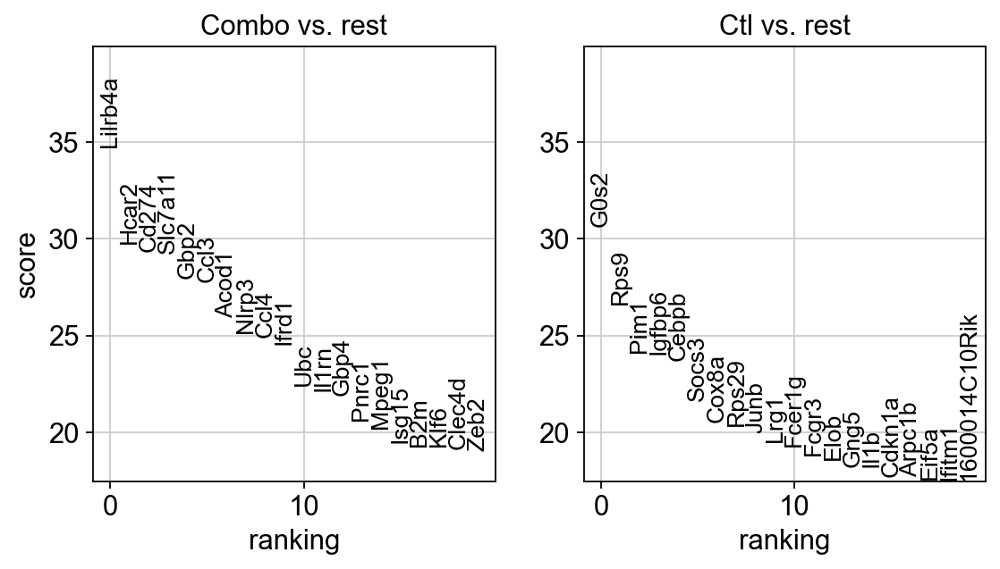

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_treat']`


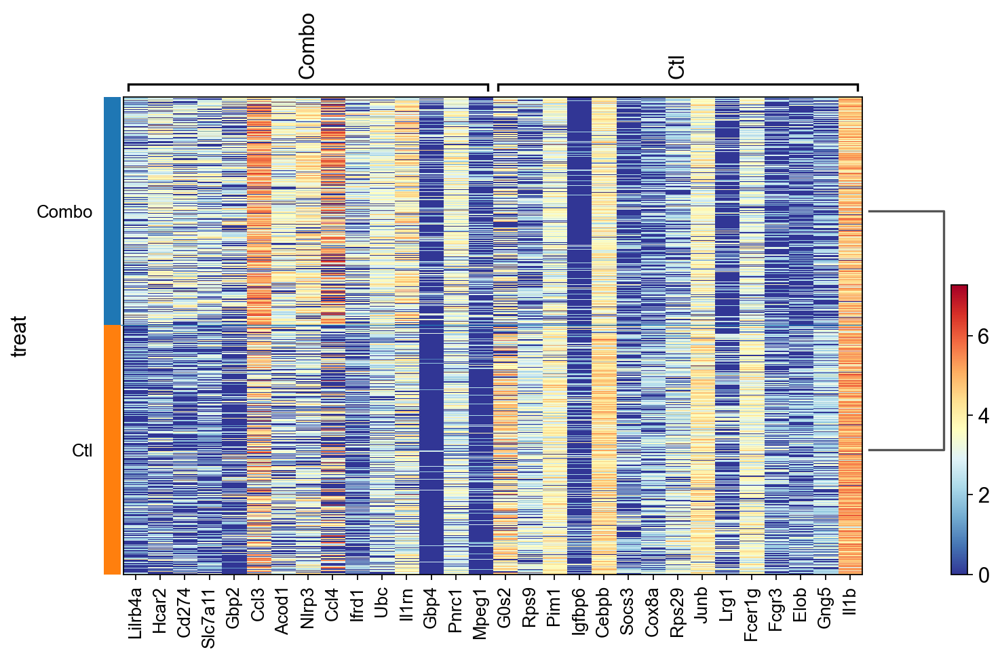

In [721]:
plt.rcParams["figure.figsize"] = (4,4)
sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Combo','Ctl'],key_added='Neu_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Ctl'],reference='Combo',key_added='Neu_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Combo'],reference='Ctl',key_added='Neu_DE_results',n_genes=1000)

sc.pl.rank_genes_groups(Neu, key='Neu_DE_results', groups=['Combo','Ctl'], fontsize=12)
sc.pl.rank_genes_groups_heatmap(Neu, key='Neu_DE_results', groups=['Combo','Ctl'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

In [722]:
Neu.uns['Neu_DE_results']
namelist=Neu.uns['Neu_DE_results']['names']
fold = Neu.uns['Neu_DE_results']['logfoldchanges']
padj = Neu.uns['Neu_DE_results']['pvals_adj']
outfile = open('Neu_DE_results','w')

for i,item in enumerate(namelist):
    #outfile.write(item[0]+'\t'+str(fold[i][0])+'\t'+str(padj[i][0])+'\n')
    outfile.write(item[0]+'\t'+str(padj[i][0])+'\n')
    outfile.write(item[1]+'\t'+str(padj[i][1])+'\n')
outfile.close()

In [723]:
comboexp = Neu[Neu.obs['treat']=='Combo'].X.mean(0)
ctlexp = Neu[Neu.obs['treat']=='Ctl'].X.mean(0)
comboexp

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ArrayView([-0.005484481 , -0.10051001  , -0.10730697  , ...,
           -0.17392726  ,  0.0033416317, -0.03377831  ], dtype=float32)

In [724]:
outfile = open('exp_for_GSEA.txt','w')
for i,gene in enumerate(Neu.var.index):
    outfile.write(gene+'\t'+str(comboexp[i])+'\t'+str(ctlexp[i])+'\n')
outfile.close()

In [725]:
len(comboexp)

18794

In [726]:
infile = open('ifna.txt')
outfile = open('ifna_mouse.txt','w')
for line in infile:
    outfile.write(line.lower().capitalize())
infile.close()
outfile.close()

<Figure size 320x320 with 0 Axes>

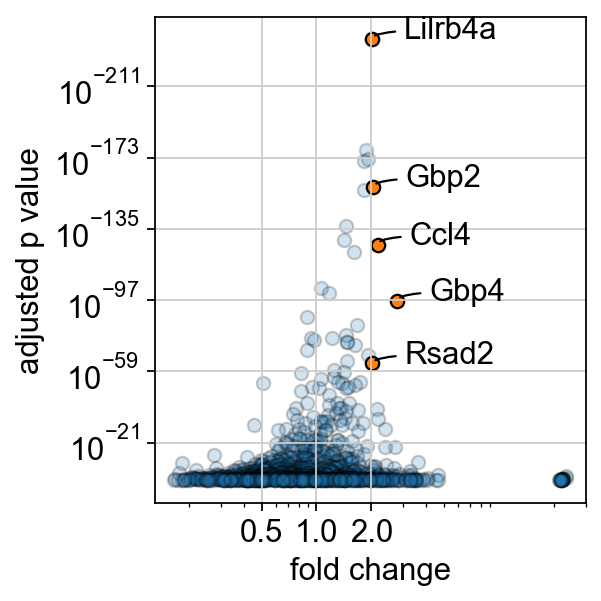

<Figure size 320x320 with 0 Axes>

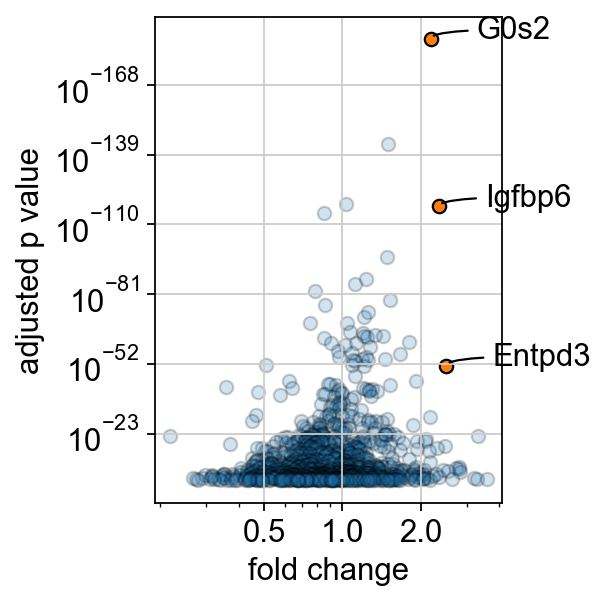

In [727]:
for i in range(2):
    plist = []
    flist = []
    nlist = []
    for pvals in padj:
        plist.append(pvals[i])
    for fvals in fold:
        flist.append(fvals[i])
    for names in namelist:
        nlist.append(names[i])
    pred = [];fred = [];nred = []
    for pval,fval,name in zip(plist,flist,nlist):
        if (pval<1e-50 and fval>2) or (pval<1e-50 and fval<0.5):
            pred.append(pval)
            fred.append(fval)
            nred.append(name)
    plt.figure()
    fig1, ax1 = plt.subplots()
    plt.scatter(flist,plist,edgecolor='black',alpha=0.2)
    plt.scatter(fred,pred,edgecolor='black')
    for i,name in enumerate(nred):
        plt.annotate(name,(fred[i],pred[i]),xytext=(fred[i]*1.5,pred[i]/2),
                    arrowprops = dict(  arrowstyle="-",
                        connectionstyle="angle3,angleA=0,angleB=-90"))
    plt.xscale('log')
    plt.yscale('log')
    plt.ylabel('adjusted p value')
    plt.xlabel('fold change')
    plt.xticks([0.5,1,2])
    ax1.get_xaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
    plt.gca().invert_yaxis()
    plt.tight_layout()

# MC/Mac/DC

In [728]:
Mo = adata[adata.obs['louvain']== 'MC/Macro/cDC']
sc.tl.leiden(Mo,resolution=0.1,key_added='louvain_r0.3_Mo' )

running Leiden clustering


Trying to set attribute `.obs` of view, copying.


    finished: found 3 clusters and added
    'louvain_r0.3_Mo', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


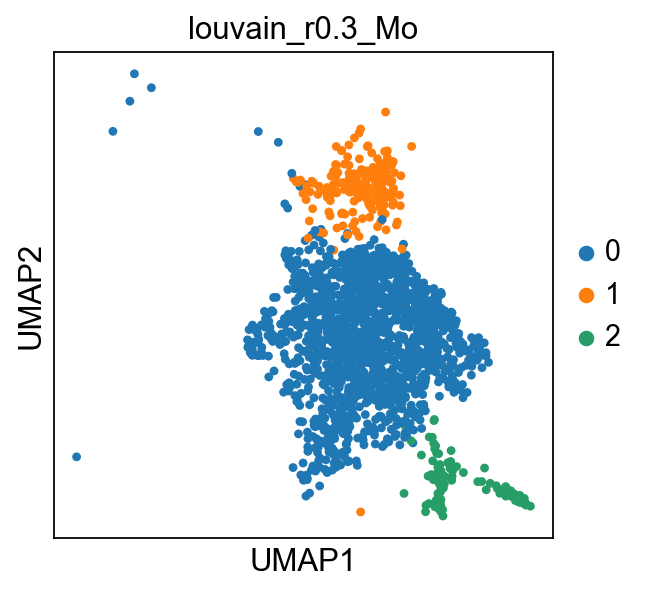

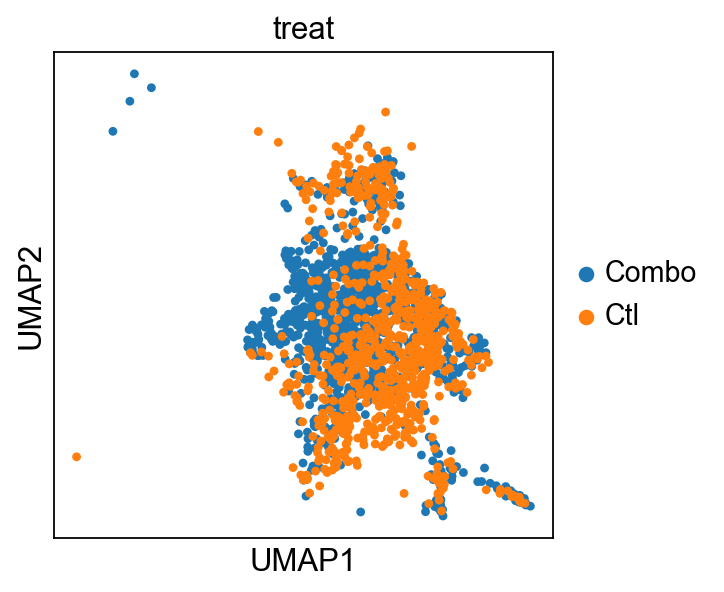

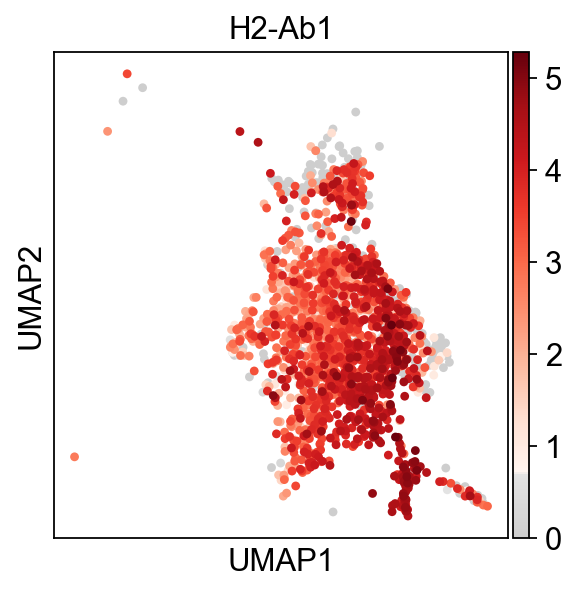

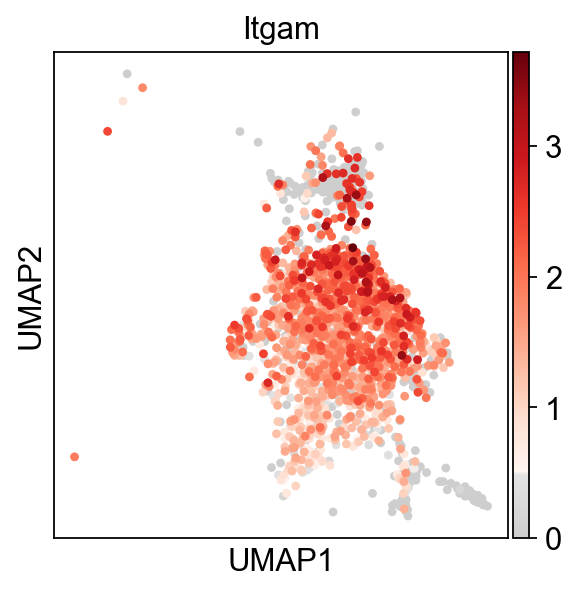

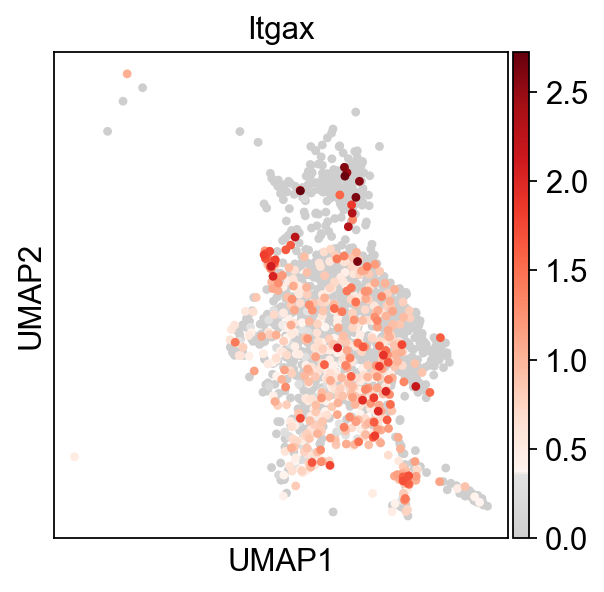

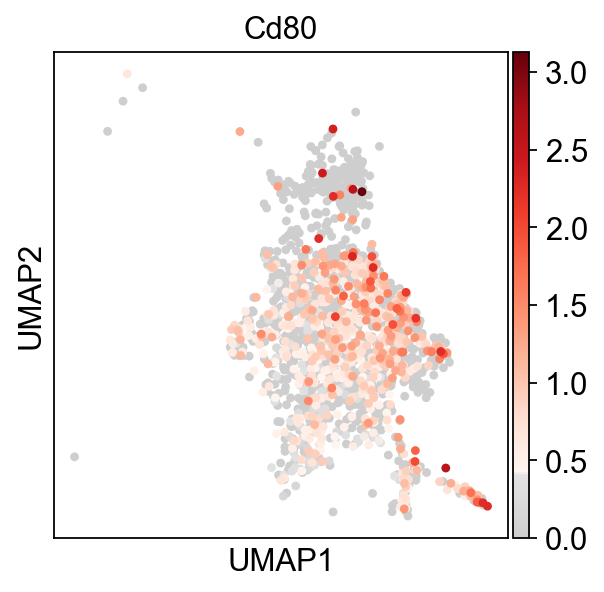

0    1592
1     200
2     118
Name: louvain_r0.3_Mo, dtype: int64

In [729]:
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(Mo, color='louvain_r0.3_Mo', palette=sc.pl.palettes.default_20)
sc.pl.umap(Mo, color='treat')
sc.pl.umap(Mo, color='H2-Ab1', use_raw=True, color_map=mymap)
sc.pl.umap(Mo, color='Itgam', use_raw=True, color_map=mymap) 
sc.pl.umap(Mo, color='Itgax', use_raw=True, color_map=mymap) 
sc.pl.umap(Mo, color='Cd80', use_raw=True, color_map=mymap) 
Mo.obs['louvain_r0.3_Mo'].value_counts()

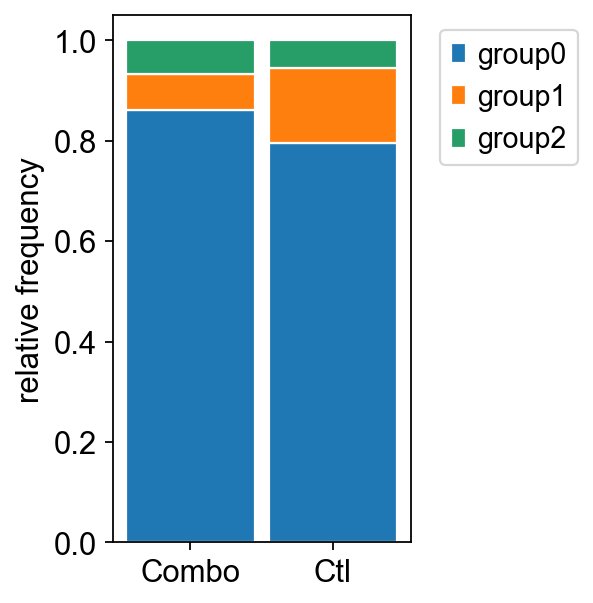

In [730]:
combocount = Mo[Mo.obs['treat']=='Combo'].obs['louvain_r0.3_Mo'].value_counts()
ctlcount = Mo[Mo.obs['treat']=='Ctl'].obs['louvain_r0.3_Mo'].value_counts()

#combocount.index[1]
plt.rcParams["figure.figsize"] = (4,4)
r=[0,1]
bottom = [0,0]
combofreq = {}
ctlfreq = {}
for i in range(len(combocount)):
    combofreq[combocount.index[i]] = combocount[i]/sum(combocount)
    ctlfreq[ctlcount.index[i]] = ctlcount[i]/sum(ctlcount)
handlelist = []
for i in range(len(combocount)):
    height = [combofreq[str(i)],ctlfreq[str(i)]]
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
plt.xticks(r,['Combo','Ctl'])
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

ranking genes
    finished: added to `.uns['Mo_Rankgenes']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


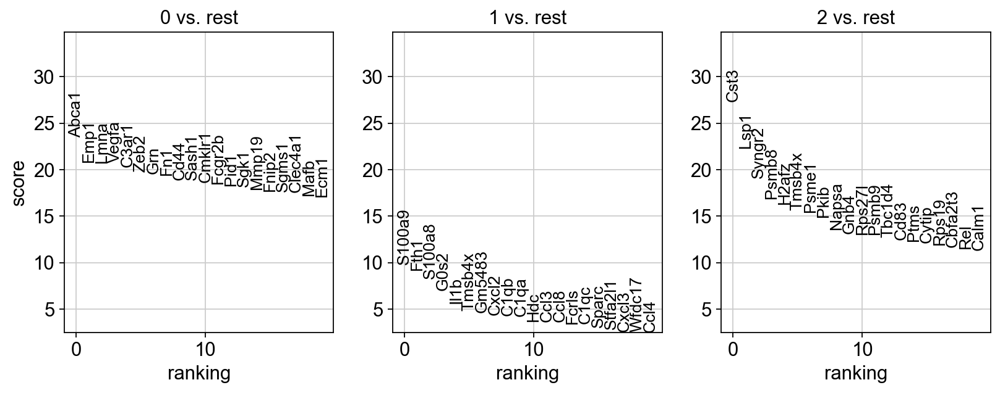

In [731]:
sc.tl.rank_genes_groups(Mo, groupby='louvain_r0.3_Mo',key_added='Mo_Rankgenes')
#sc.pl.rank_genes_groups(Mo, key='Mo_Rankgenes', groups=['0','1','2','3','4','5','6'], fontsize=12)
sc.pl.rank_genes_groups(Mo, key='Mo_Rankgenes', groups=['0','1','2'], fontsize=12)

['Cd86', 'Cd80', 'Cd68', 'Il1r1', 'Tlr2', 'Tlr4', 'Nos2', 'Socs3', 'Cd163', 'Chil3', 'Arg1', 'Egr2', 'Cd200r1', 'Mrc1', 'Tgm2', 'Tlr1', 'Tlr8', 'Btla', 'Ccr7', 'Dpp4', 'Kit', 'Flt3', 'Xcr1', 'Ifi205', 'Hepacam2', 'Cd36', 'Tlr3', 'Eno2', 'Ankrd33b', 'Extl1', 'Fah', 'Cd81', 'Gcsam', 'Xcr1', 'Irf8', 'Sirpa', 'S100a4', 'Cd209a']


<AxesSubplot:>

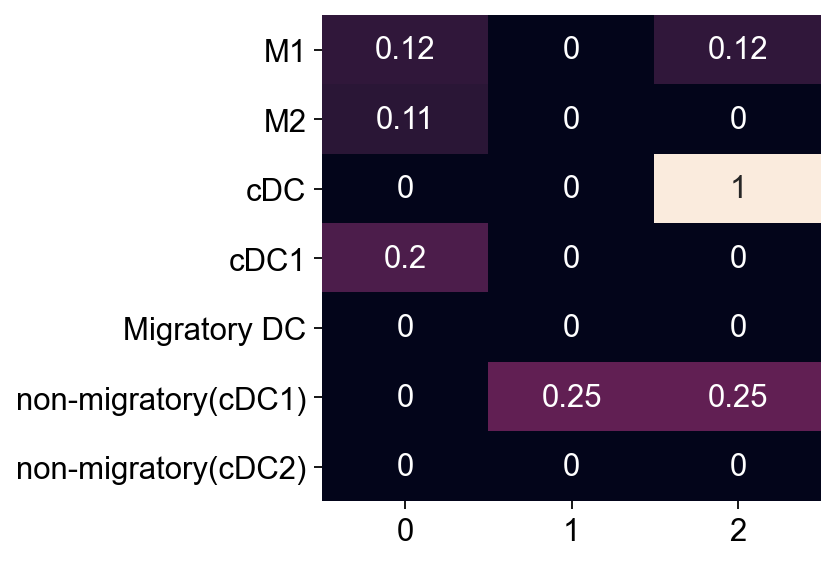

In [732]:
plt.rcParams["figure.figsize"] = (4,4)
reffile = 'ref_gene_M.txt'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene for gene in genelist]
marker_genes_M = refdict
marker_genes_M
marker_genes_M_list=[]
for key in marker_genes_M:
    marker_genes_M_list.extend(marker_genes_M[key])
#marker_genes_M_list=list(dict.fromkeys(marker_genes_M_list))
print((marker_genes_M_list))
    
cell_annotation_M = sc.tl.marker_gene_overlap(Mo, marker_genes_M, key='Mo_Rankgenes',top_n_markers=200)
cell_annotation_norm = sc.tl.marker_gene_overlap(Mo, marker_genes_M, key='Mo_Rankgenes', normalize='reference',top_n_markers=200)
#cell_annotation_all = sc.tl.marker_gene_overlap(adata, marker_genes_M, key='Mo_Rankgenes')
#cell_annotation_M
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sb.heatmap(cell_annotation_all, cbar=False, annot=True)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['louvain_r0.3_Mo']"]`


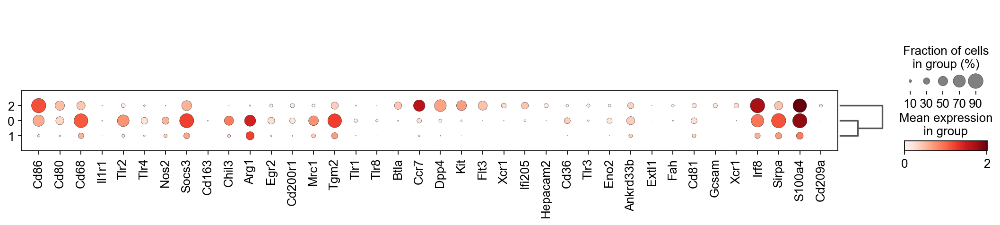

In [733]:
sc.pl.dotplot(Mo, marker_genes_M_list, groupby='louvain_r0.3_Mo', dendrogram=True)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


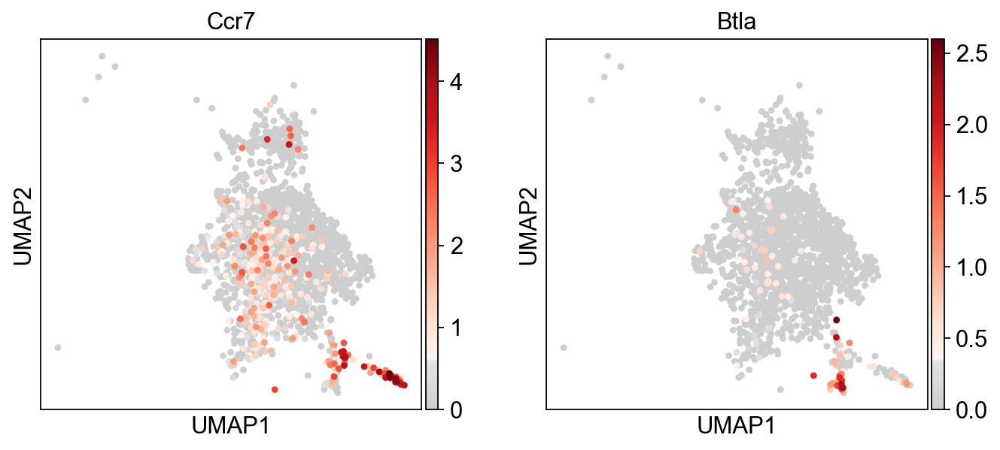

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


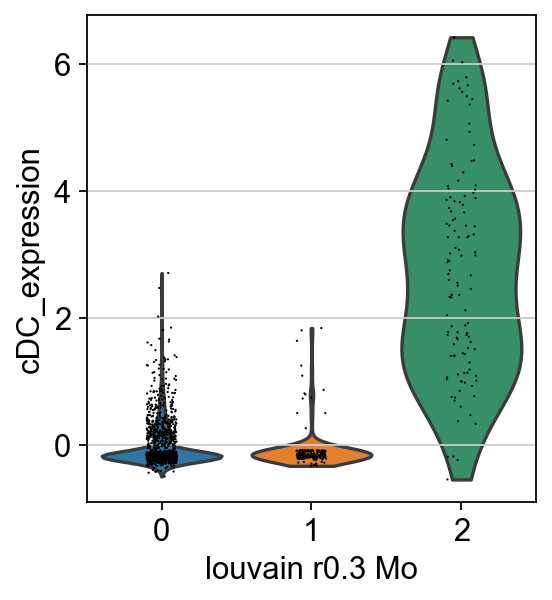

Index(['Dpp4', 'Kit', 'Flt3', 'Ccr7', 'Btla'], dtype='object')

In [734]:
#Check individual cDC markers
plt.rcParams["figure.figsize"] = (4,4)
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['cDC'])] 
sc.pl.umap(Mo, color=stem_genes[3:], title=stem_genes[3:], color_map=mymap)

#Check stem marker expression
Mo.obs['cDC_expression'] = Mo[:,stem_genes].X.mean(1)

sc.pl.violin(Mo, 'cDC_expression', groupby='louvain_r0.3_Mo')
#sc.pl.umap(Mo, color='cDC_expression', color_map=mymap)
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['cDC'])] 
stem_genes

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


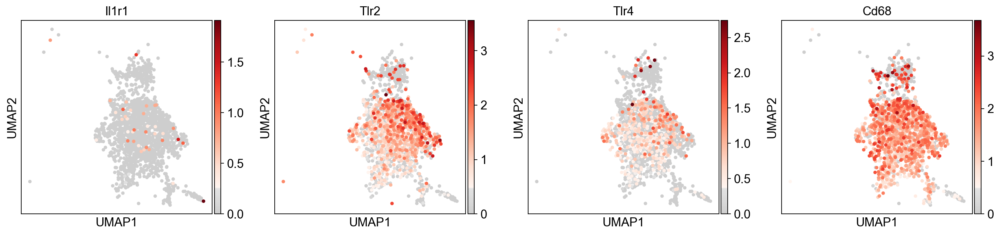

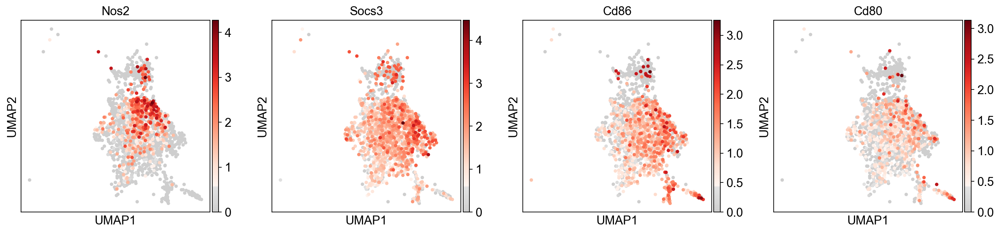

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


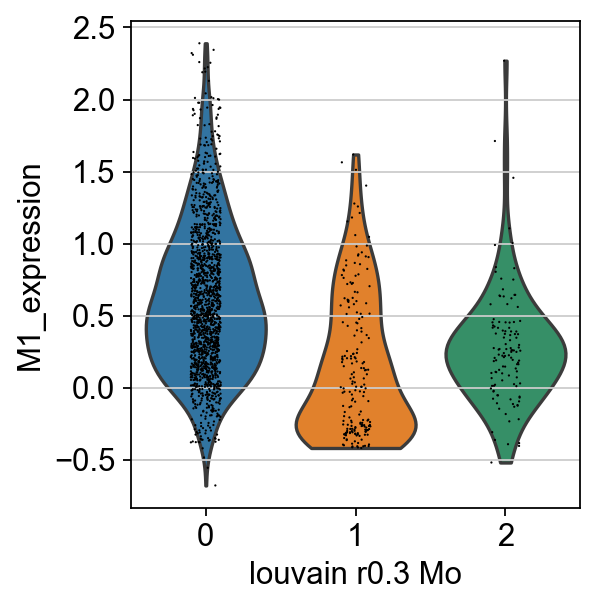

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


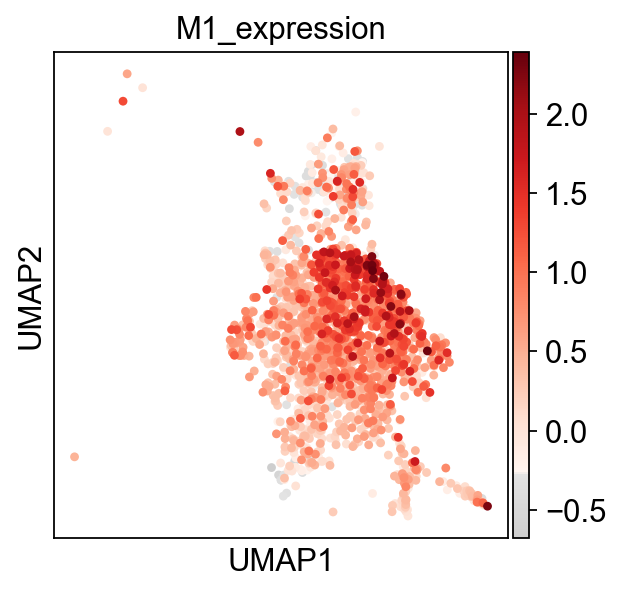

In [735]:
#Check individual M1 markers
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['M1'])]
sc.pl.umap(Mo, color=stem_genes[:4], title=stem_genes[:4], color_map=mymap)
sc.pl.umap(Mo, color=stem_genes[4:], title=stem_genes[4:], color_map=mymap)

#Check stem marker expression
Mo.obs['M1_expression'] = Mo[:,stem_genes].X.mean(1)

sc.pl.violin(Mo, 'M1_expression', groupby='louvain_r0.3_Mo')
sc.pl.umap(Mo, color='M1_expression', color_map=mymap)


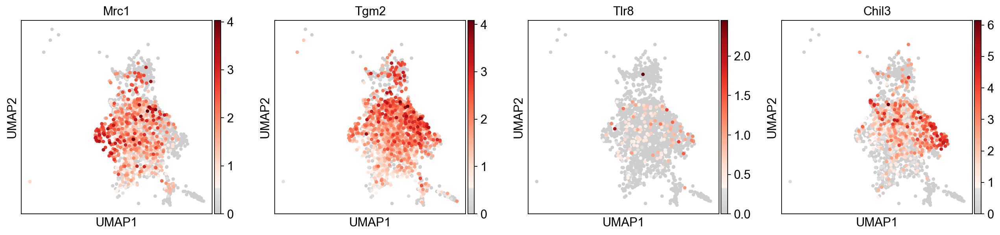

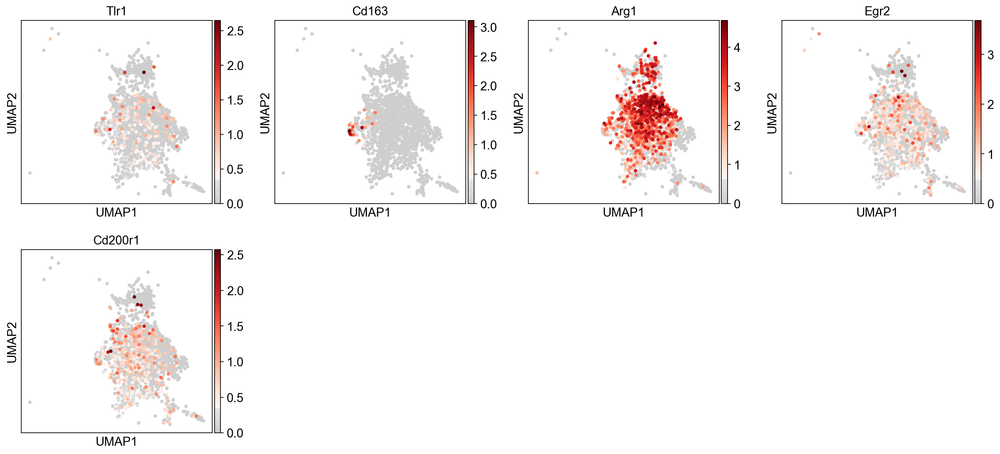

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


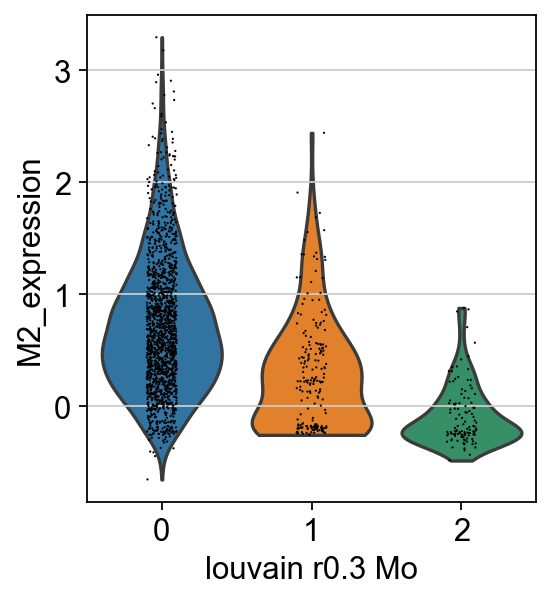

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


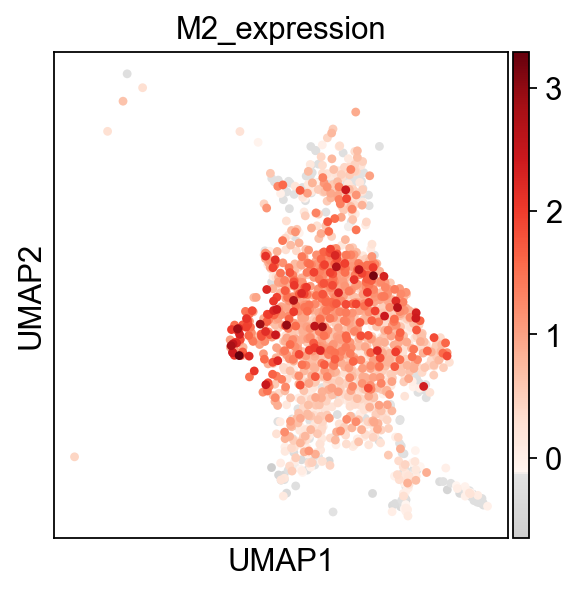

In [736]:
#Check individual M2 markers
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['M2'])]
sc.pl.umap(Mo, color=stem_genes[:4], title=stem_genes[:4], color_map=mymap)
sc.pl.umap(Mo, color=stem_genes[4:], title=stem_genes[4:], color_map=mymap)

#Check stem marker expression
Mo.obs['M2_expression'] = Mo[:,stem_genes].X.mean(1)

sc.pl.violin(Mo, 'M2_expression', groupby='louvain_r0.3_Mo')
sc.pl.umap(Mo, color='M2_expression', color_map=mymap)

In [737]:
cDC=Mo[Mo.obs['louvain_r0.3_Mo']=='2']

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ranking genes


Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['cDC_DE_results']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_treat']`


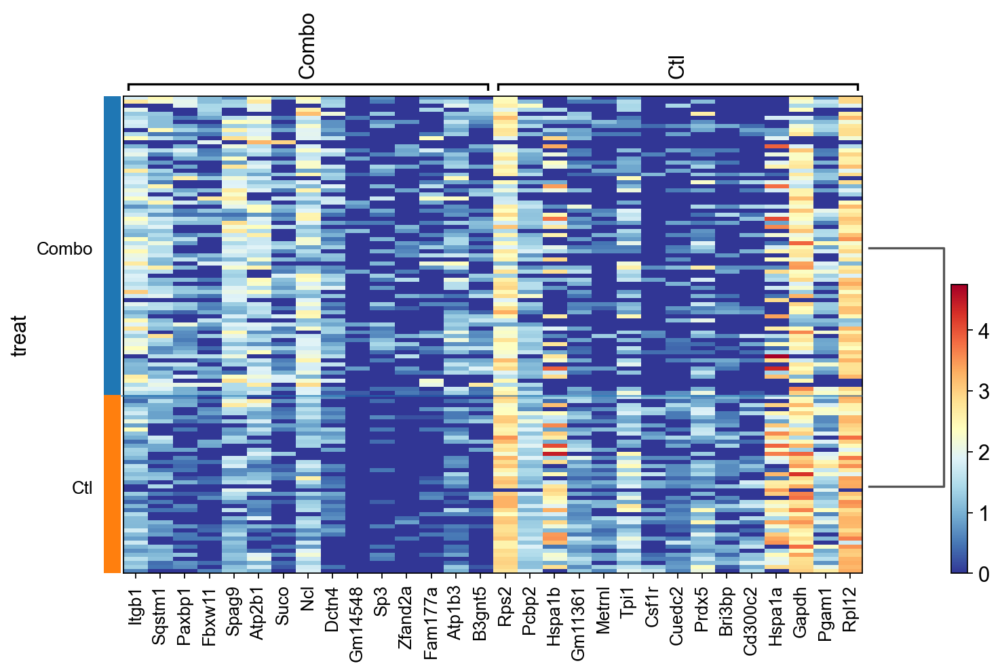

In [738]:
plt.rcParams["figure.figsize"] = (5,5)
sc.tl.rank_genes_groups(cDC, groupby='treat',groups=['Combo','Ctl'],key_added='cDC_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Ctl'],reference='Combo',key_added='Neu_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Combo'],reference='Ctl',key_added='Neu_DE_results',n_genes=1000)

#sc.pl.rank_genes_groups(cDC, key='cDC_DE_results', fontsize=12)
sc.pl.rank_genes_groups_heatmap(cDC, key='cDC_DE_results', groups=['Combo','Ctl'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

In [739]:
#M= Mo[ (Mo.obs['louvain_r0.3_Mo']=='0')| (Mo.obs['louvain_r0.3_Mo']=='1')| (Mo.obs['louvain_r0.3_Mo']=='2')]
M= Mo[ (Mo.obs['louvain_r0.3_Mo']=='0')| (Mo.obs['louvain_r0.3_Mo']=='1')]

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ranking genes


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['M_DE_results']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


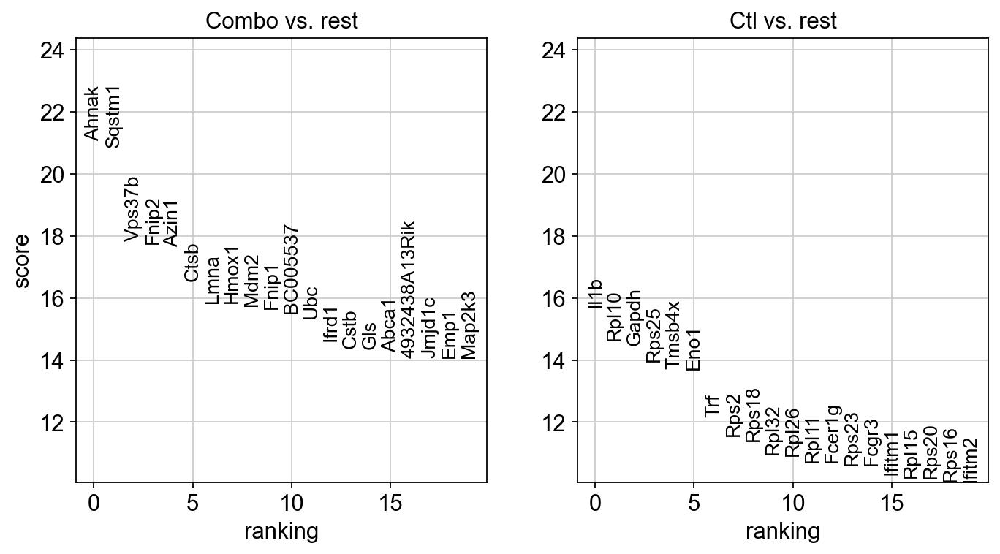

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_treat']`


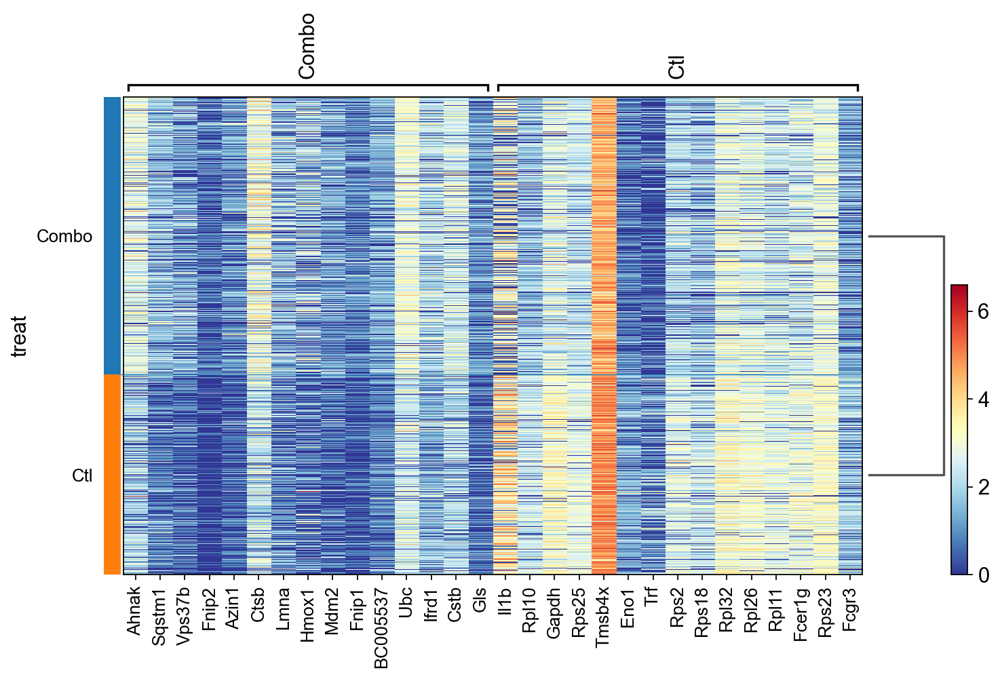

In [740]:
plt.rcParams["figure.figsize"] = (5,5)
sc.tl.rank_genes_groups(M, groupby='treat',groups=['Combo','Ctl'],key_added='M_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(M, groupby='treat',groups=['Ctl'],reference='Combo',key_added='M_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Combo'],reference='Ctl',key_added='Neu_DE_results',n_genes=1000)

namelist=M.uns['M_DE_results']['names']
fold = M.uns['M_DE_results']['logfoldchanges']
padj = M.uns['M_DE_results']['pvals_adj']
outfile = open('M_DE_results','w')
#print (namelist)
for i,item in enumerate(namelist):
    outfile.write(item[0]+'\t'+str(fold[i][0])+'\t'+str(padj[i][0])+'\n')
    #outfile.write(item[0]+'\t'+str(padj[i][0])+'\n')
    #outfile.write(item[1]+'\t'+str(padj[i][1])+'\n')
outfile.close()

sc.pl.rank_genes_groups(M, key='M_DE_results', groups=['Combo','Ctl'], fontsize=12)
sc.pl.rank_genes_groups_heatmap(M, key='M_DE_results', groups=['Combo','Ctl'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')
#sc.pl.rank_genes_groups(M, key='M_DE_results', groups=['Ctl'], fontsize=12)
#sc.pl.rank_genes_groups_heatmap(M, key='M_DE_results', groups=['Combo'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

Ctl vs. Combo, Show upregulation of Rps genes. Not really meaningful.
Combo vs. Ctl:




Enrichment:
Red- immune response process ; Blue: Cellular response to stimulus; Yellow: Regulation of cell communication



In [741]:
Mo[Mo.obs['treat']=='Ctl'].obs['louvain_r0.3_Mo'].value_counts()  

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


0    632
1    119
2     44
Name: louvain_r0.3_Mo, dtype: int64

In [742]:
Mo[Mo.obs['treat']=='Combo'].obs['louvain_r0.3_Mo'].value_counts()  

0    960
1     81
2     74
Name: louvain_r0.3_Mo, dtype: int64

# T cells

In [743]:
Tdata = adata[adata.obs['louvain']== 'T cells']
sc.tl.leiden(Tdata,resolution=1,key_added='louvain_r0.5_T' )


running Leiden clustering


Trying to set attribute `.obs` of view, copying.


    finished: found 11 clusters and added
    'louvain_r0.5_T', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


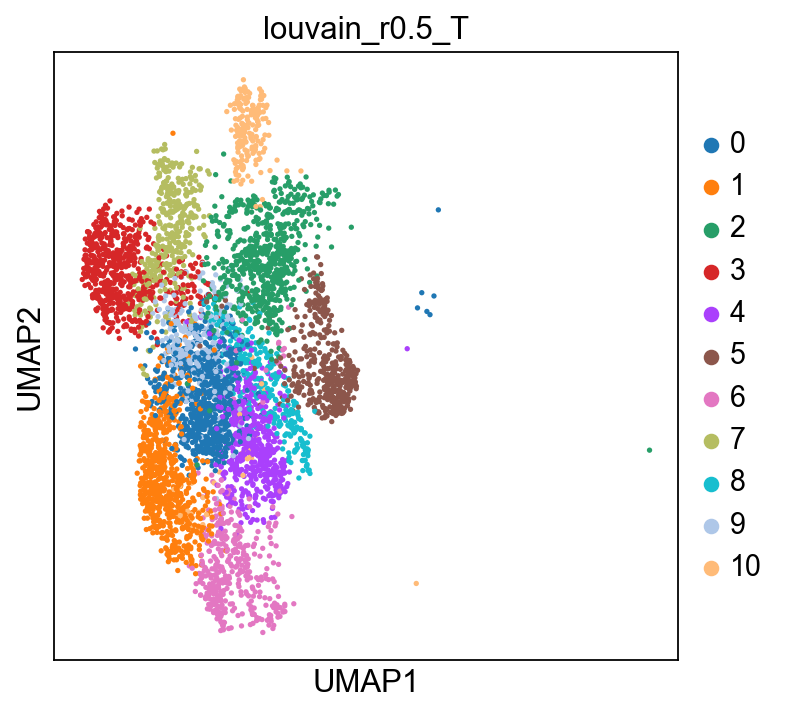

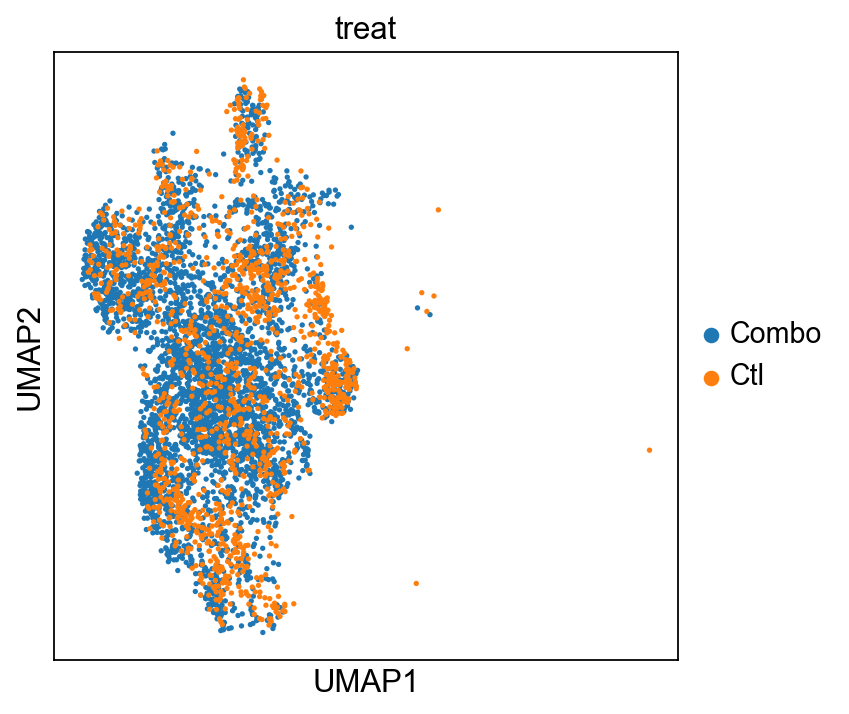

Trying to set attribute `.uns` of view, copying.


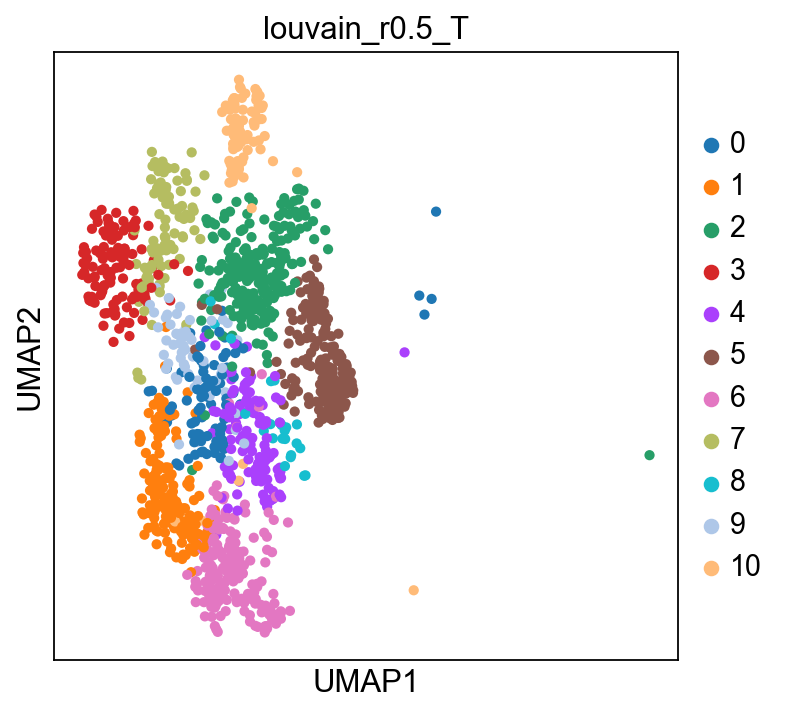

Trying to set attribute `.uns` of view, copying.


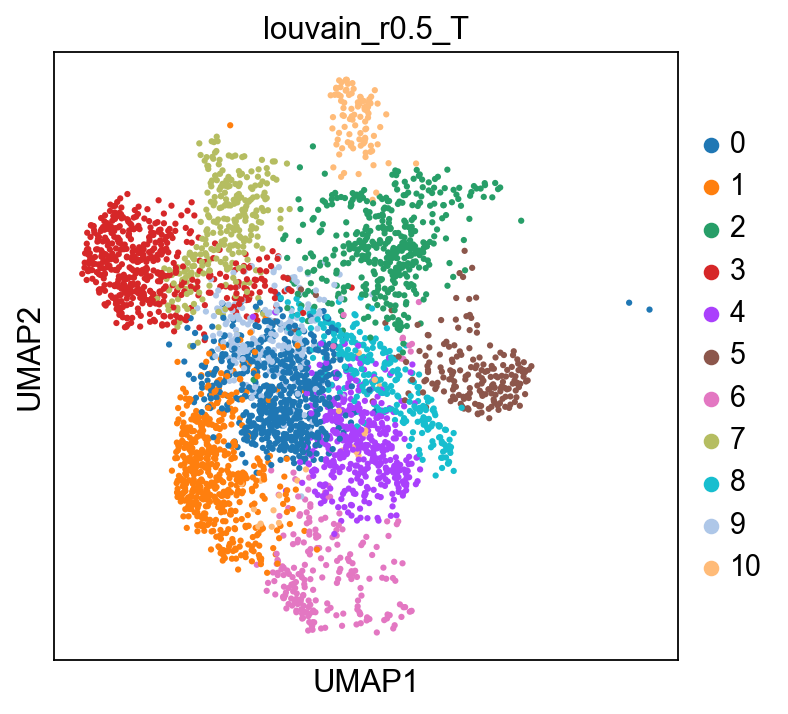

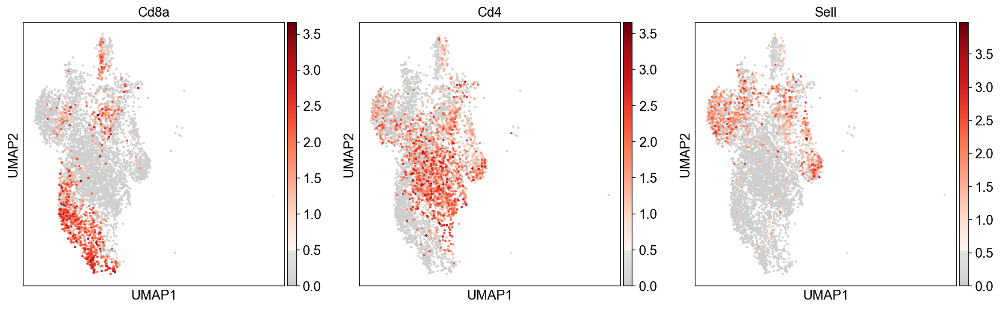

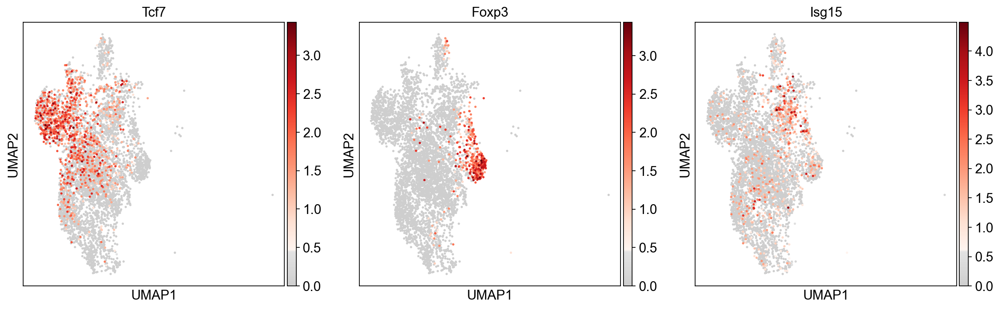

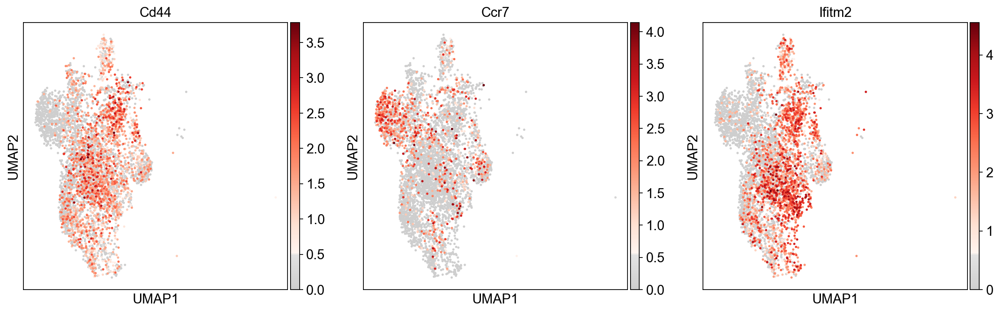

In [744]:
plt.rcParams["figure.figsize"] = (5,5)
sc.pl.umap(Tdata, color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)
sc.pl.umap(Tdata, color='treat')
sc.pl.umap(Tdata[Tdata.obs['treat']=='Ctl'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)
sc.pl.umap(Tdata[Tdata.obs['treat']=='Combo'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)
sc.pl.umap(Tdata, color=['Cd8a','Cd4','Sell'], use_raw=True, color_map=mymap) 
#sc.pl.umap(Tdata, color='Cd4', use_raw=True, color_map=mymap) 
#sc.pl.umap(Tdata, color='Sell', use_raw=True, color_map=mymap) 
sc.pl.umap(Tdata, color=['Tcf7','Foxp3','Isg15'], use_raw=True, color_map=mymap) 
sc.pl.umap(Tdata, color=['Cd44','Ccr7','Ifitm2'], use_raw=True, color_map=mymap) 
#sc.pl.umap(Tdata, color='Ccr7', use_raw=True, color_map=mymap) 


Trying to set attribute `.uns` of view, copying.


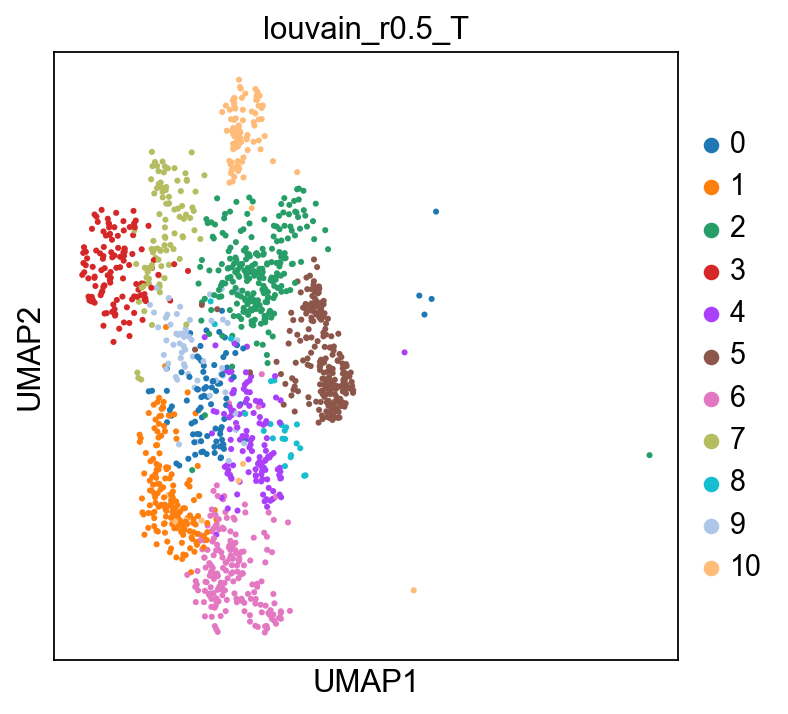

In [746]:
ax = sc.pl.umap(Tdata[Tdata.obs['treat']=='Ctl'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=30,show=False)

#sc.pl.umap(Tdata[Tdata.obs['treat']=='Combo'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=100,ax=ax)
#sc.pl.umap(Tdata[Tdata.obs['treat']=='Ctl'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=100,ax=ax)

Trying to set attribute `.uns` of view, copying.


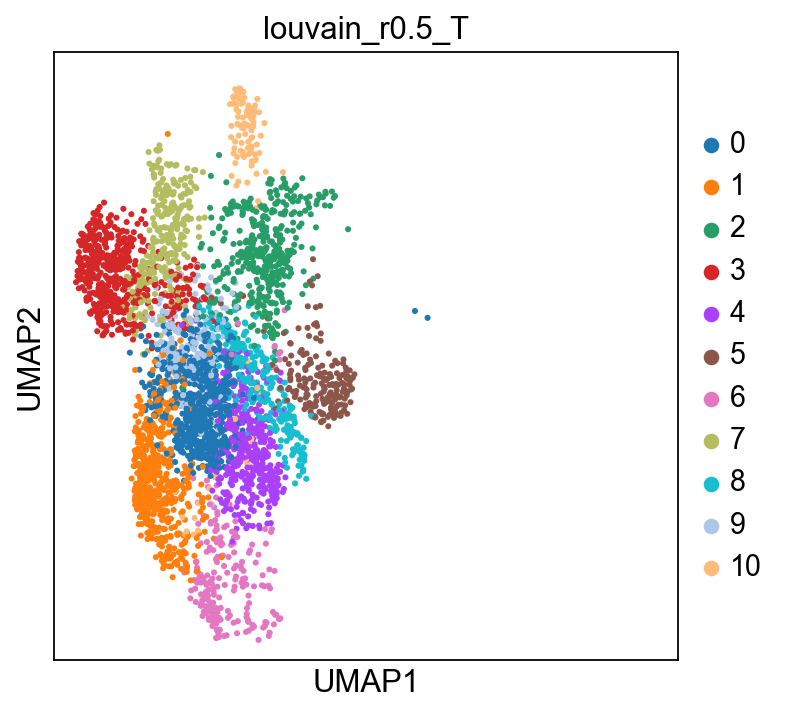

In [747]:
fig,ax2 = plt.subplots()
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
sc.pl.umap(Tdata[Tdata.obs['treat']=='Combo'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=30,ax=ax2)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['louvain_r0.5_T']"]`


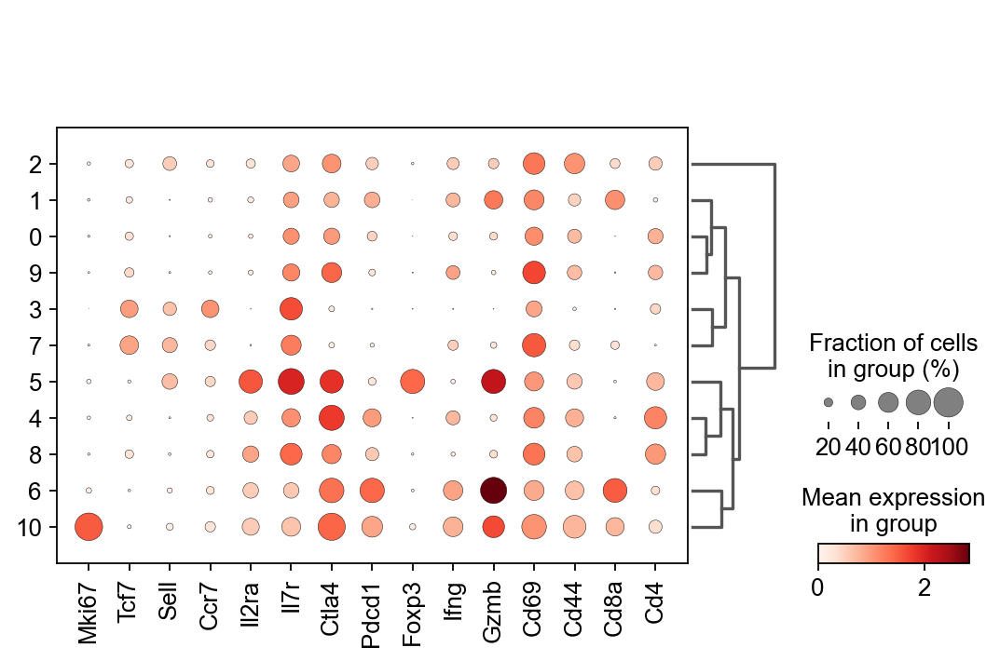

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


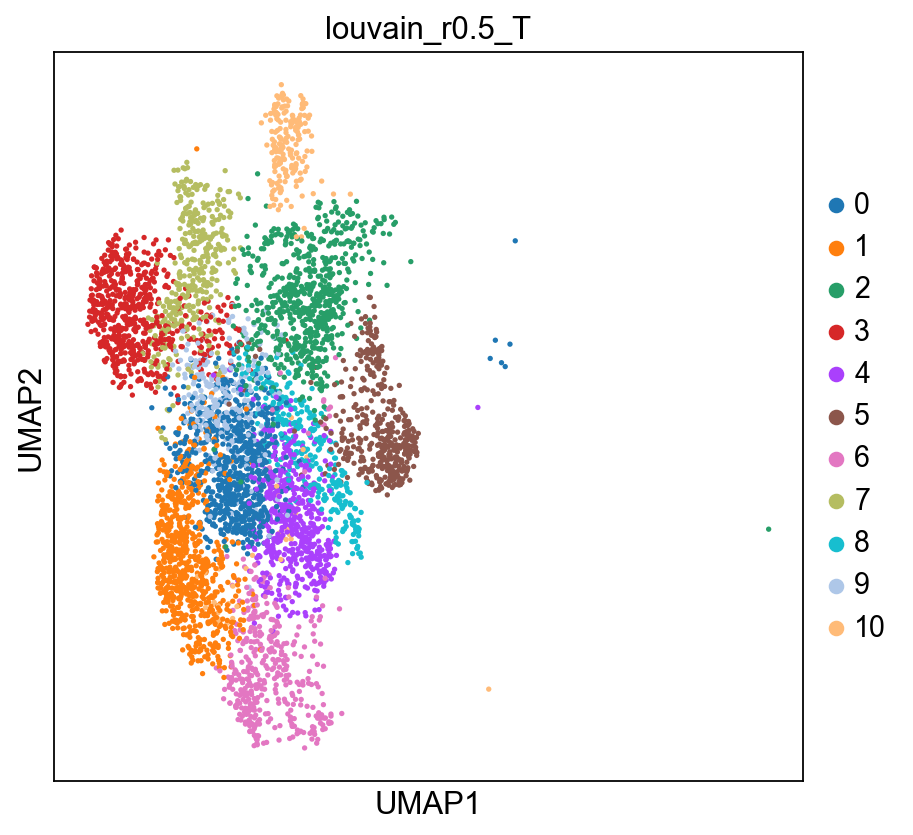

In [748]:
plt.rcParams["figure.figsize"] = (6,6)
Marker_T=['Mki67','Tcf7','Sell','Ccr7','Il2ra','Il7r','Ctla4','Pdcd1','Foxp3','Ifng','Gzmb','Cd69','Cd44','Cd8a','Cd4']
sc.pl.dotplot(Tdata, Marker_T, groupby='louvain_r0.5_T', dendrogram=True)
sc.pl.umap(Tdata, color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)


ranking genes
    finished: added to `.uns['T_Rankgenes']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


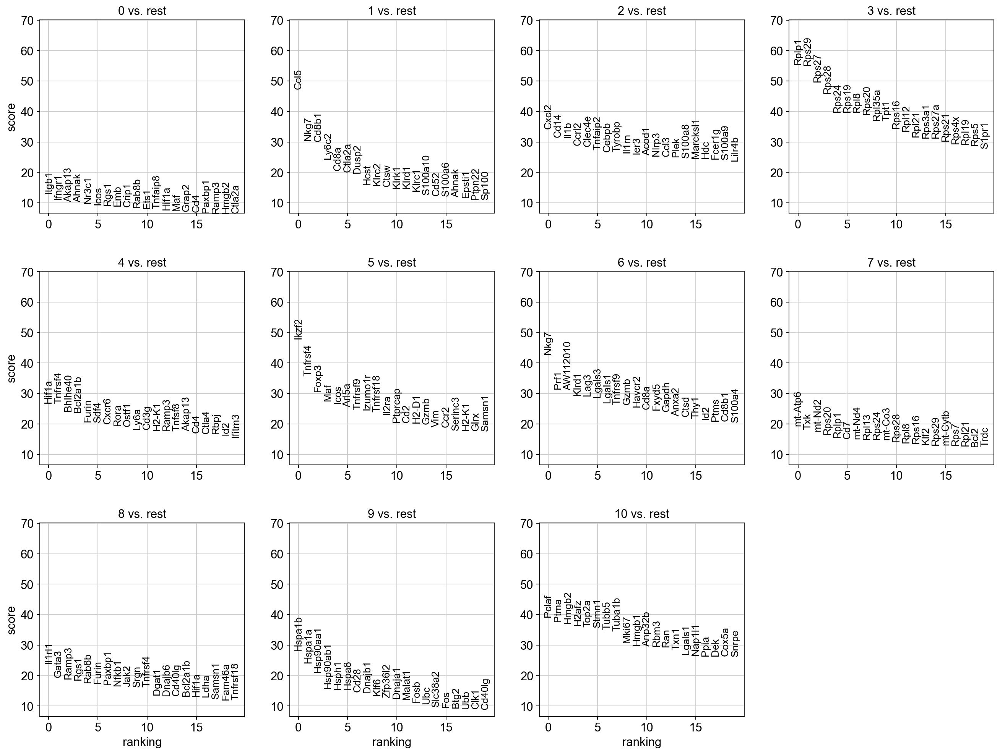

In [749]:
plt.rcParams["figure.figsize"] = (5,5)
sc.tl.rank_genes_groups(Tdata, groupby='louvain_r0.5_T',key_added='T_Rankgenes')
sc.pl.rank_genes_groups(Tdata, key='T_Rankgenes', groups=['0','1','2','3','4','5','6','7','8','9','10'], fontsize=12)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


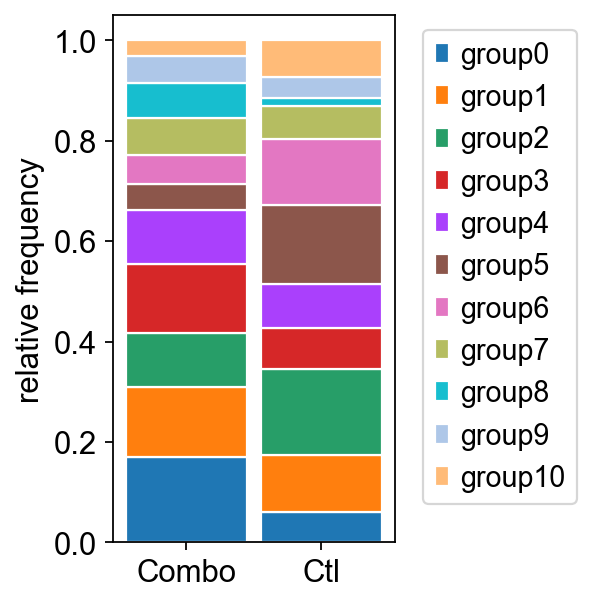

In [750]:
combocount = Tdata[Tdata.obs['treat']=='Combo'].obs['louvain_r0.5_T'].value_counts()
ctlcount = Tdata[Tdata.obs['treat']=='Ctl'].obs['louvain_r0.5_T'].value_counts()

#combocount.index[1]
plt.rcParams["figure.figsize"] = (4,4)
r=[0,1]
bottom = [0,0]
combofreq = {}
ctlfreq = {}
for i in range(len(combocount)):
    combofreq[combocount.index[i]] = combocount[i]/sum(combocount)
    ctlfreq[ctlcount.index[i]] = ctlcount[i]/sum(ctlcount)
handlelist = []
for i in range(len(combocount)):
    height = [combofreq[str(i)],ctlfreq[str(i)]]
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
plt.xticks(r,['Combo','Ctl'])
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

<AxesSubplot:>

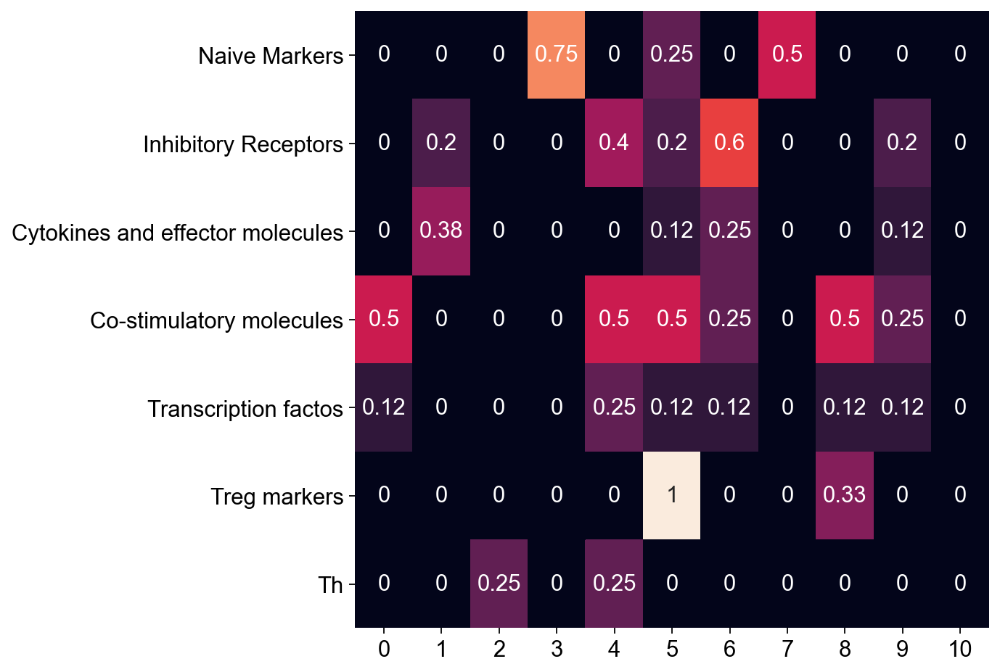

In [751]:
plt.rcParams["figure.figsize"] = (7,7)
cell_annotation_norm = sc.tl.marker_gene_overlap(Tdata, marker_genes_Zhang, key='T_Rankgenes', normalize='reference',top_n_markers=100)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sc.pl.umap(Tdata, color=['Cd8a','Cd4','louvain_r0.5_T'], use_raw=True, color_map=mymap) 

<AxesSubplot:>

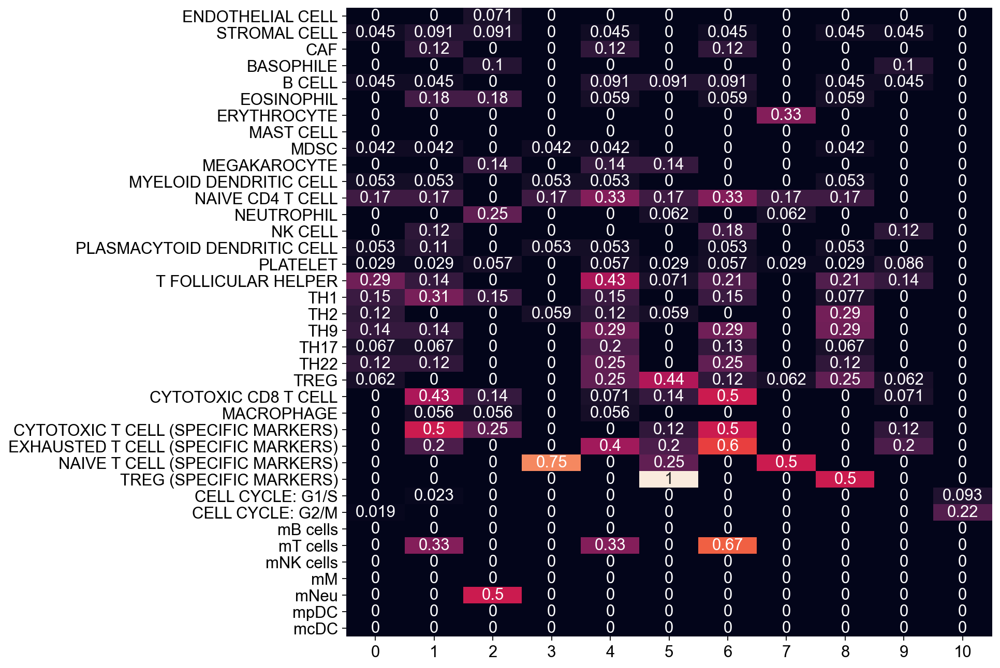

In [752]:
plt.rcParams["figure.figsize"] = (10,10)
cell_annotation_norm = sc.tl.marker_gene_overlap(Tdata, marker_genes, key='T_Rankgenes', normalize='reference',top_n_markers=100)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)

([<matplotlib.axis.XTick at 0x7fa53148b490>,
 [Text(0, 0, 'Tcf7'),
  Text(1, 0, 'Sell'),
  Text(2, 0, 'Lef1'),
  Text(3, 0, 'Ccr7'),
  Text(4, 0, 'Lag3'),
  Text(5, 0, 'Tigit'),
  Text(6, 0, 'Pdcd1'),
  Text(7, 0, 'Havcr2'),
  Text(8, 0, 'Ctla4'),
  Text(9, 0, 'Il2'),
  Text(10, 0, 'Gzma'),
  Text(11, 0, 'Prf1'),
  Text(12, 0, 'Gzmb'),
  Text(13, 0, 'Gzmk'),
  Text(14, 0, 'Ifng'),
  Text(15, 0, 'Cd28'),
  Text(16, 0, 'Tnfrsf14'),
  Text(17, 0, 'Icos'),
  Text(18, 0, 'Tnfrsf9'),
  Text(19, 0, 'Eomes'),
  Text(20, 0, 'Hopx'),
  Text(21, 0, 'Tbx21'),
  Text(22, 0, 'Zeb2'),
  Text(23, 0, 'Hif1a'),
  Text(24, 0, 'Id2'),
  Text(25, 0, 'Tox'),
  Text(26, 0, 'Il2ra'),
  Text(27, 0, 'Foxp3'),
  Text(28, 0, 'Ikzf2'),
  Text(29, 0, 'Tbx21'),
  Text(30, 0, 'Csf1'),
  Text(31, 0, 'Ifitm2')])

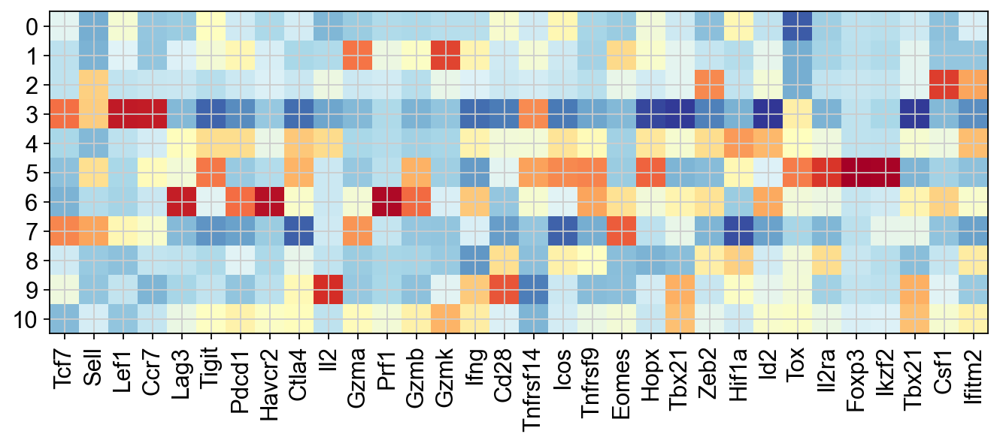

In [753]:
markerlist=[]
for key in marker_genes_Zhang:
    markerlist.extend(marker_genes_Zhang[key])
markerlist
meanexp_Zhang = marker_gene_expression(Tdata,markerlist,'louvain_r0.5_T')

plt.rcParams["figure.figsize"] = (10,10)
tmpdf = meanexp_Zhang.filter(items=list(meanexp_Zhang)[:11]).transpose()
df_norm_col=(tmpdf-tmpdf.mean())/tmpdf.std()
plt.imshow(df_norm_col, cmap='RdYlBu_r')
plt.yticks(np.arange(len(list(meanexp_Zhang)[:11])),list(meanexp_Zhang)[:11])
plt.xticks(np.arange(len(list(meanexp_Zhang.index))),list(meanexp_Zhang.index),rotation='vertical')

([<matplotlib.axis.YTick at 0x7fa5a0c72ee0>,
 [Text(0, 0, 'Tcf7'),
  Text(0, 1, 'Sell'),
  Text(0, 2, 'Lef1'),
  Text(0, 3, 'Ccr7'),
  Text(0, 4, 'Lag3'),
  Text(0, 5, 'Tigit'),
  Text(0, 6, 'Pdcd1'),
  Text(0, 7, 'Havcr2'),
  Text(0, 8, 'Ctla4'),
  Text(0, 9, 'Il2'),
  Text(0, 10, 'Gzma'),
  Text(0, 11, 'Prf1'),
  Text(0, 12, 'Gzmb'),
  Text(0, 13, 'Gzmk'),
  Text(0, 14, 'Ifng'),
  Text(0, 15, 'Cd28'),
  Text(0, 16, 'Tnfrsf14'),
  Text(0, 17, 'Icos'),
  Text(0, 18, 'Tnfrsf9'),
  Text(0, 19, 'Eomes'),
  Text(0, 20, 'Hopx'),
  Text(0, 21, 'Tbx21'),
  Text(0, 22, 'Zeb2'),
  Text(0, 23, 'Hif1a'),
  Text(0, 24, 'Id2'),
  Text(0, 25, 'Tox'),
  Text(0, 26, 'Il2ra'),
  Text(0, 27, 'Foxp3'),
  Text(0, 28, 'Ikzf2'),
  Text(0, 29, 'Tbx21'),
  Text(0, 30, 'Csf1'),
  Text(0, 31, 'Ifitm2')])

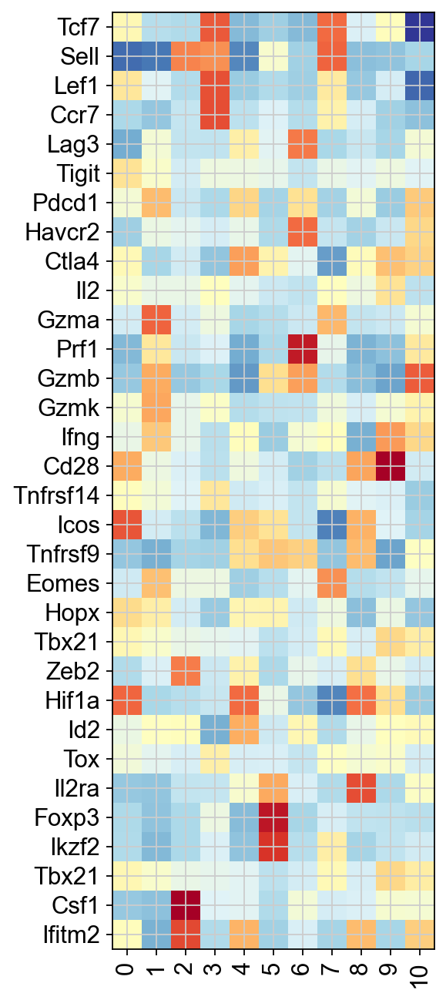

In [754]:
tmpdf = meanexp_Zhang.filter(items=list(meanexp_Zhang)[:11])
df_norm_col=(tmpdf-tmpdf.mean())/tmpdf.std()
plt.imshow(df_norm_col, cmap='RdYlBu_r')
plt.xticks(np.arange(len(list(meanexp_Zhang)[:11])),list(meanexp_Zhang)[:11],rotation=90)
plt.yticks(np.arange(len(list(meanexp_Zhang.index))),list(meanexp_Zhang.index))

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r0.5_T']`


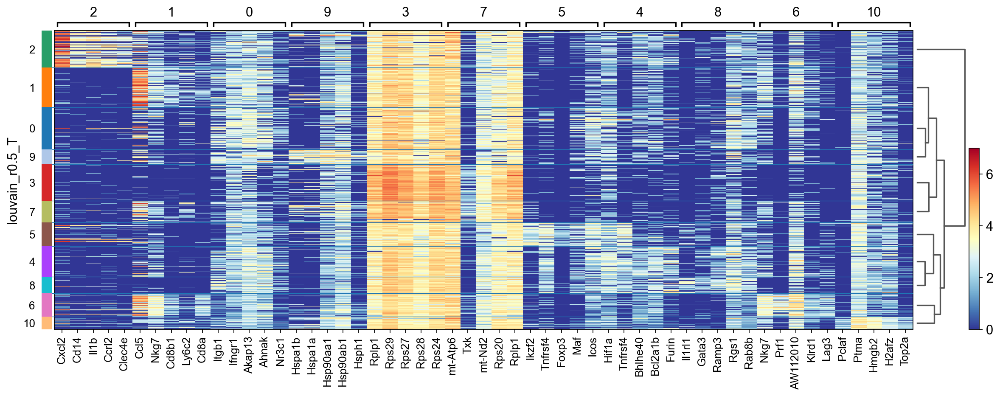

In [755]:
sc.pl.rank_genes_groups_heatmap(Tdata, key='T_Rankgenes',n_genes=5,show_gene_labels=True, cmap='RdYlBu_r',interpolation='none',save='Tr1.heatmap.pdf')


In [756]:
namelist=Tdata.uns['T_Rankgenes']['names']
outfile = open('Rank_genes_T_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in namelist:
    outfile.write('\t'.join(item)+'\n')
outfile.close()

loglist=Tdata.uns['T_Rankgenes']['logfoldchanges']
outfile = open('Rank_genes_foldchange_T_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

pvals_list=Tdata.uns['T_Rankgenes']['pvals_adj']
outfile = open('Rank_genes_pvals_adj_T_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


Ctla4 Ttest_indResult(statistic=array([3.1426659], dtype=float32), pvalue=array([0.0017945669]))
Havcr2 Ttest_indResult(statistic=array([-2.8024633], dtype=float32), pvalue=array([0.0053095822]))
Lag3 Ttest_indResult(statistic=array([-0.8620788], dtype=float32), pvalue=array([0.3891432266]))
Tigit Ttest_indResult(statistic=array([-2.2510886], dtype=float32), pvalue=array([0.0249037736]))
Foxp3 Ttest_indResult(statistic=array([-2.225998], dtype=float32), pvalue=array([0.0265519905]))


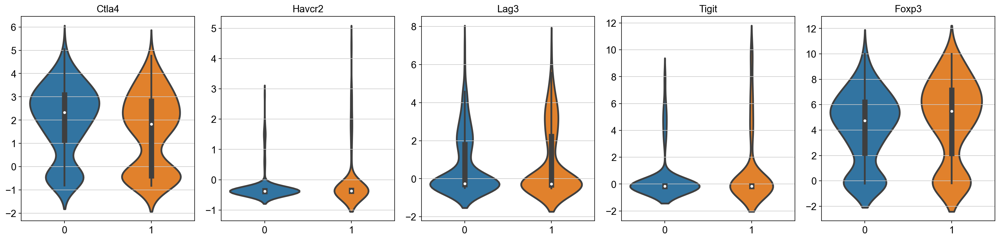

In [757]:
Treg=Tdata[Tdata.obs['louvain_r0.5_T']=='5']

plt.figure(figsize=(20,5))
ploti=0
gdata={}
for gene in ['Ctla4','Havcr2','Lag3','Tigit','Foxp3']:
    ploti += 1
    gdata['Ctl']=Treg[Treg.obs['treat']=='Ctl'][:,Treg.var.index==gene].X
    gdata['Combo']=Treg[Treg.obs['treat']=='Combo'][:,Treg.var.index==gene].X
    #tmpdata['key']=list(gdata.keys())
    #tmpdata['Exp']=[list(gdata['Ctl']),list(gdata['Combo'])]

    test=[list(gdata['Ctl']),list(gdata['Combo'])]
    print(gene, sp.stats.ttest_ind(list(gdata['Ctl']),list(gdata['Combo'])))
    #plt.hist(list((gdata['Ctl'])))
    plt.subplot(1,5,ploti)

 #   sb.boxplot(data=test,linewidth=2.5,width=0.8)
#    sb.swarmplot(data=test,alpha=.75,color='.25')
    
    sb.violinplot(data=test,linewidth=2.5,width=0.8)
    plt.title(gene)

plt.tight_layout()
plt.show()

ranking genes


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['Treg_DE_results']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


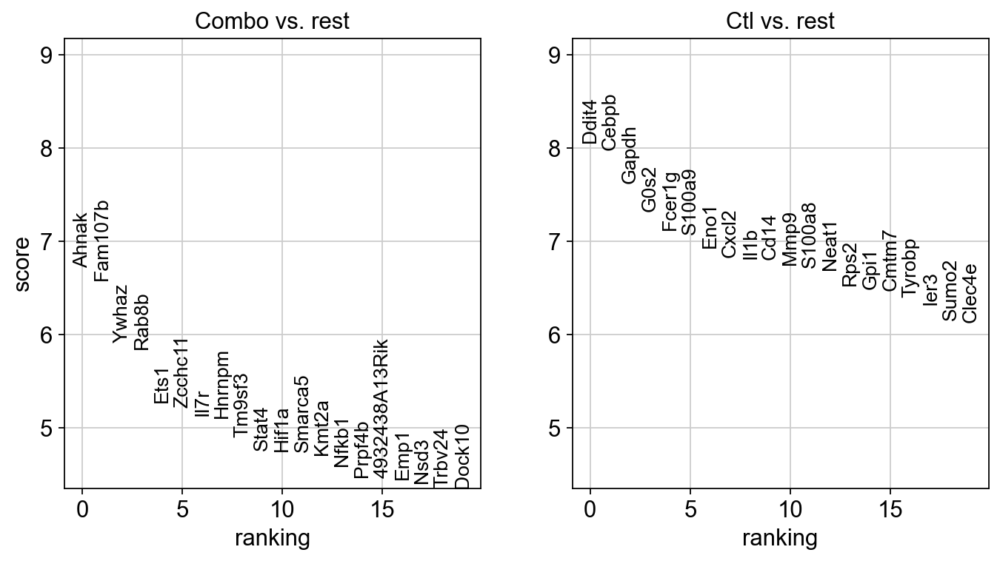

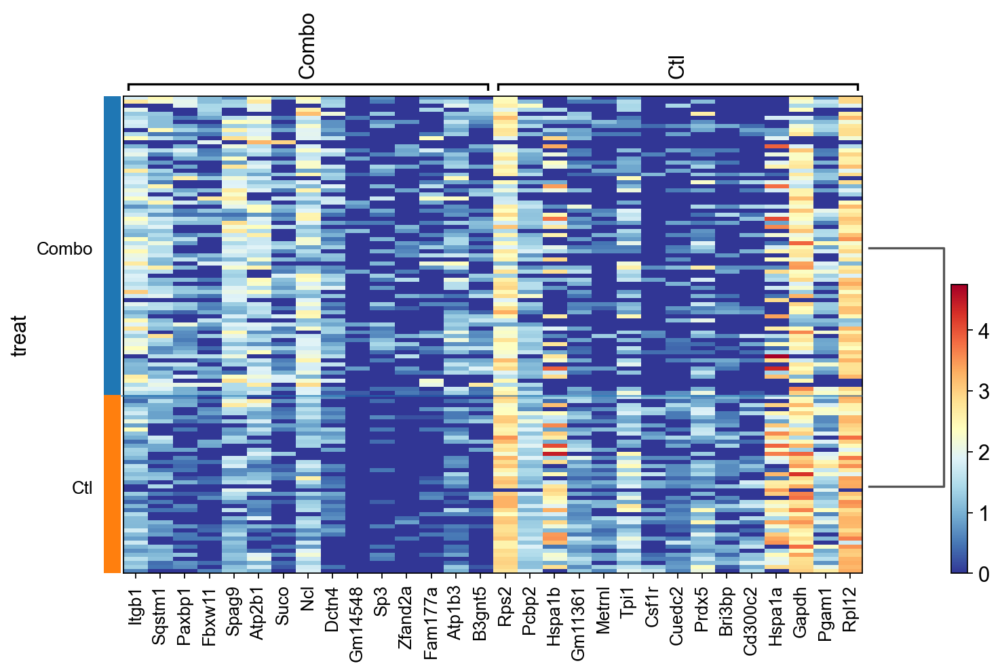

In [758]:
plt.rcParams["figure.figsize"] = (5,5)
sc.tl.rank_genes_groups(Treg, groupby='treat',groups=['Combo','Ctl'],key_added='Treg_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Ctl'],reference='Combo',key_added='Neu_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Combo'],reference='Ctl',key_added='Neu_DE_results',n_genes=1000)

sc.pl.rank_genes_groups(Treg, key='Treg_DE_results', groups=['Combo','Ctl'], fontsize=12)
sc.pl.rank_genes_groups_heatmap(cDC, key='cDC_DE_results', groups=['Combo','Ctl'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

In [759]:
Treg[Treg.obs['treat']=='Combo'][:,Treg.var.index==gene].X

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ArrayView([[ 4.841579  ],
           [ 4.082651  ],
           [-0.18570665],
           [-0.17541286],
           [-0.15166116],
           [ 2.2639709 ],
           [ 4.945791  ],
           [ 4.3607836 ],
           [ 5.391281  ],
           [-0.16275486],
           [ 7.0514555 ],
           [ 6.7075315 ],
           [ 8.252499  ],
           [-0.1503997 ],
           [ 8.732883  ],
           [ 5.538004  ],
           [-0.15363312],
           [ 7.1153345 ],
           [ 7.1417103 ],
           [ 8.648536  ],
           [ 5.7485347 ],
           [ 8.221227  ],
           [ 7.721522  ],
           [ 7.5013857 ],
           [ 5.6732583 ],
           [ 8.68227   ],
           [ 9.547641  ],
           [-0.15718018],
           [-0.18159646],
           [-0.16778186],
           [ 6.3790526 ],
           [ 6.825676  ],
           [ 6.449316  ],
           [ 6.929002  ],
           [ 4.0941963 ],
           [ 6.6225386 ],
           [ 6.2561316 ],
           [ 6.829661  ],
           [

In [760]:
adata.write('../../data1/CD45+_3M_processed_Scanpy2.h5ad')

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


## Trajectory and pusdo-timing

In [761]:
CD8_sub= Tdata[ (Tdata.obs['louvain_r0.5_T']=='1')| (Tdata.obs['louvain_r0.5_T']=='6') | (Tdata.obs['louvain_r0.5_T']=='7')]
CD4_sub= Tdata[ (Tdata.obs['louvain_r0.5_T']!='1') & (Tdata.obs['louvain_r0.5_T']!='6') & (Tdata.obs['louvain_r0.5_T']!='10') & (Tdata.obs['louvain_r0.5_T']!='7')]



computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


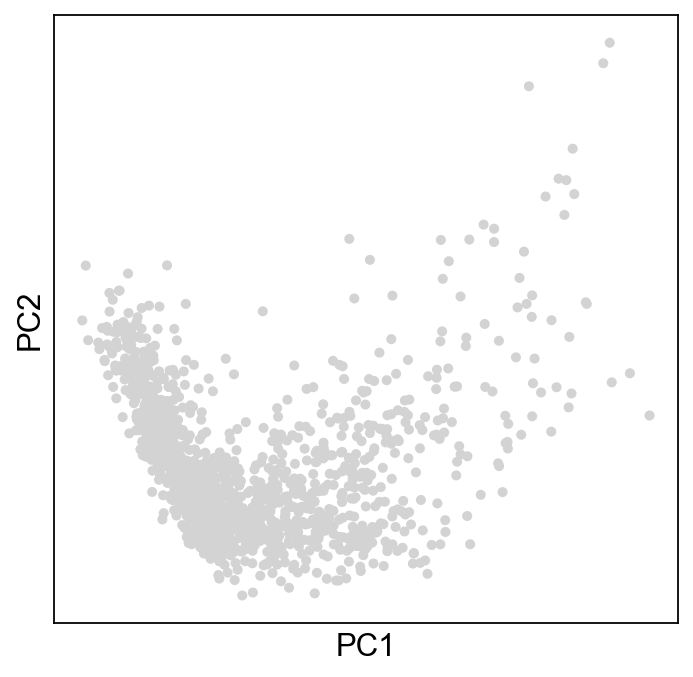

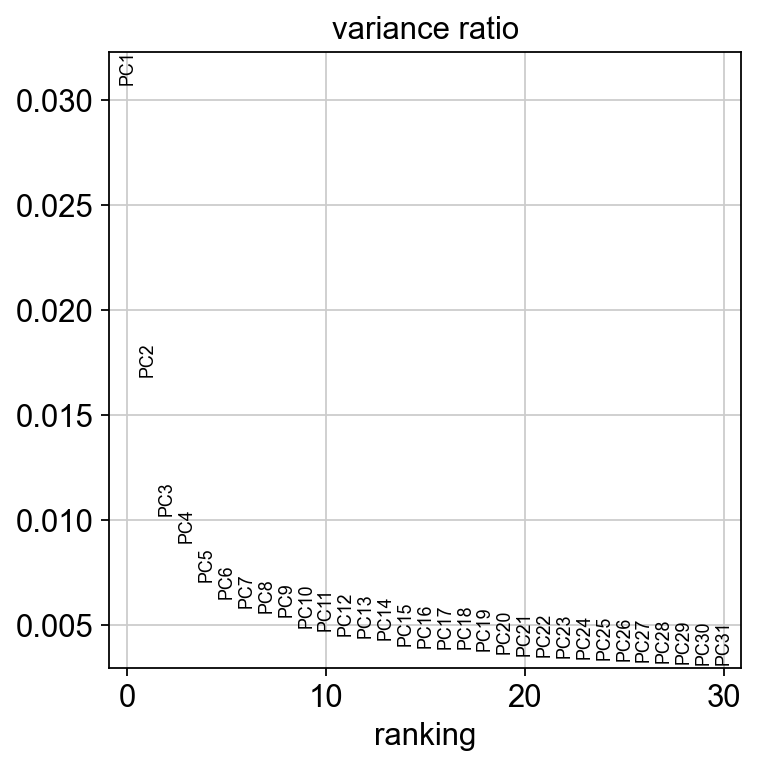

computing PCA
    on highly variable genes
    with n_comps=50


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


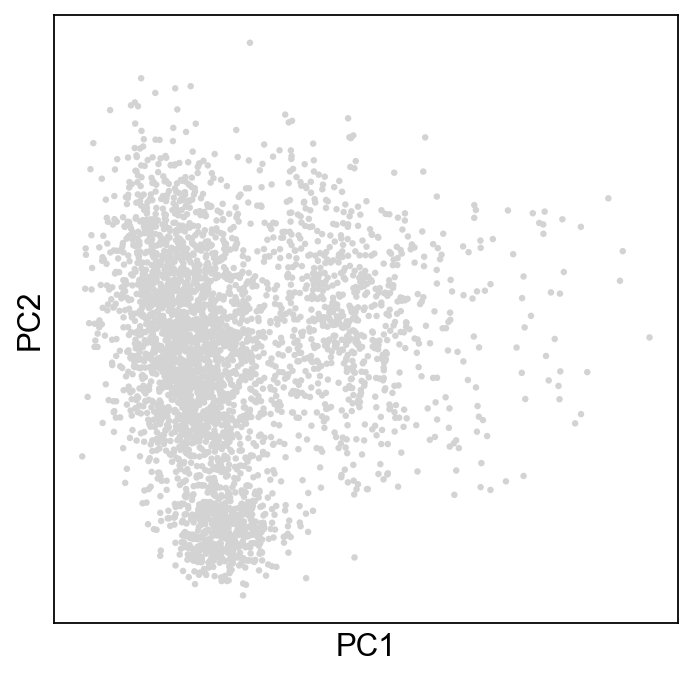

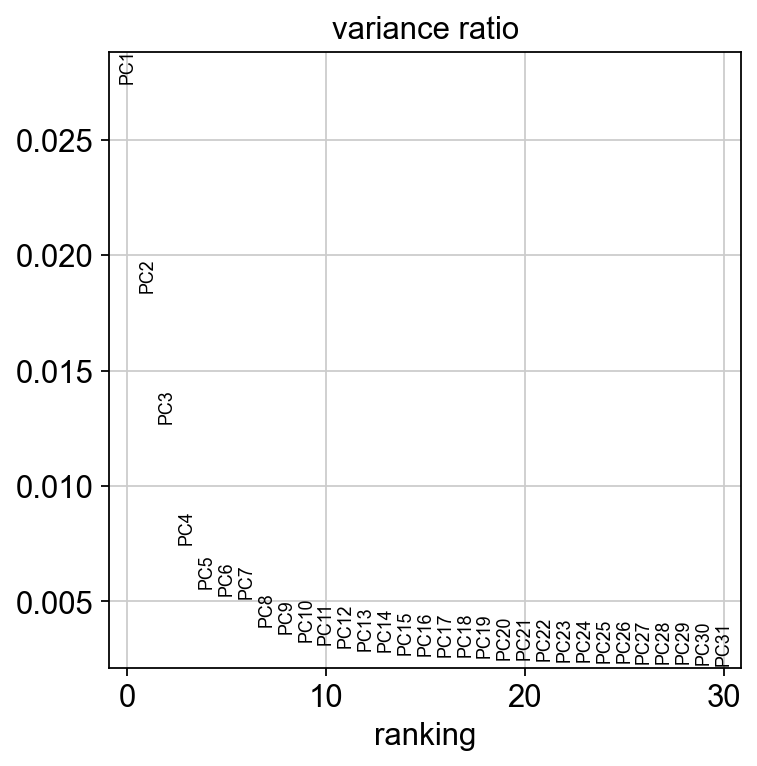

In [762]:
#Recalculating PCA for subset
sc.pp.pca(CD8_sub, svd_solver='arpack')
sc.pl.pca(CD8_sub)
sc.pl.pca_variance_ratio(CD8_sub)
#Recalculating PCA for subset
sc.pp.pca(CD4_sub, svd_solver='arpack')
sc.pl.pca(CD4_sub)
sc.pl.pca_variance_ratio(CD4_sub)

In [763]:
CD8_sub.obsm['X_pca'] = CD8_sub.obsm['X_pca'][:,0:10]
CD4_sub.obsm['X_pca'] = CD4_sub.obsm['X_pca'][:,0:10]

# 3.5.1 Slingshot

Slingshot is written in R. The integration of R in this notebook is again achieved via the rpy2 interface. We use a specifically developed package called anndata2ri (https://www.github.com/flying-sheep/anndata2ri), that takes care of the conversion from an AnnData object to SingleCellExperiment object in R. It should be noted that the convention for scRNA-seq data matrix storage in R is opposite to python. In R the expression matrix is stored as genes x cells rather than cells x genes. Thus, the matrix must be transposed before being input into the R function. This is already taken care of by anndata2ri.
We are loading the normalized, log-transformed, and batch-corrected data as we want to minimize technical variation in the inferred trajectories.
Implementation note:

this section closely follows the online Slingshot tutorial

In [764]:
import logging
import rpy2
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [765]:
%%R
# Load libraries from correct lib Paths for my environment - ignore this!
#.libPaths(.libPaths()[c(3,2,1)])

# Load all the R libraries we will be using in the notebook
#library(scran)
library(RColorBrewer)
library(slingshot)
#library(monocle)
#library(gam)
#library(clusterExperiment)
#library(ggplot2)
#library(plyr)
#library(MAST)

In [767]:
CD8_sub2 = CD8_sub
#CD8_sub2
del CD8_sub2.uns['neighbors']

In [768]:
CD4_sub2 = CD4_sub
#CD8_sub2
del CD4_sub2.uns['neighbors']

In [769]:
%%R -i CD8_sub2 
print(CD8_sub2)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata2ri/py2r.py:38: NotConvertedWarning: Conversion 'py2rpy' not defined for objects of type '<class 'NoneType'>'
  warn(str(e), NotConvertedWarning)


class: SingleCellExperiment 
dim: 18794 1470 
metadata(14): log1p hvg ... T_Rankgenes dendrogram_louvain_r0.5_T
assays(1): X
rownames(18794): Sox17 Mrpl15 ... CAAA01118383.1 CAAA01147332.1
rowData names(14): gene_ids feature_types ... mean std
colnames(1470): AAACCCATCGGCTATA-1-0 AAACGAAAGATGCGAC-1-0 ...
  TTTCGATTCACCATGA-1-1 TTTGGAGGTTTGGCTA-1-1
colData names(15): treat doublet ... louvain louvain_r0.5_T
reducedDimNames(3): PCA UMAP TSNE
spikeNames(0):
altExpNames(0):


In [770]:
%%R -i CD4_sub2 
print(CD4_sub2)

class: SingleCellExperiment 
dim: 18794 3513 
metadata(14): log1p hvg ... T_Rankgenes dendrogram_louvain_r0.5_T
assays(1): X
rownames(18794): Sox17 Mrpl15 ... CAAA01118383.1 CAAA01147332.1
rowData names(14): gene_ids feature_types ... mean std
colnames(3513): AAACCCAAGAAACTGT-1-0 AAACCCACACCAATTG-1-0 ...
  TTTGGTTTCCGATGTA-1-1 TTTGTTGAGCGGGTTA-1-1
colData names(15): treat doublet ... louvain louvain_r0.5_T
reducedDimNames(3): PCA UMAP TSNE
spikeNames(0):
altExpNames(0):


[1] "1:"
class: SlingshotDataSet 

 Samples Dimensions
    1470         10

lineages: 1 
Lineage1: 7  1  6  

curves: 1 
Curve1: Length: 70.754	Samples: 1470


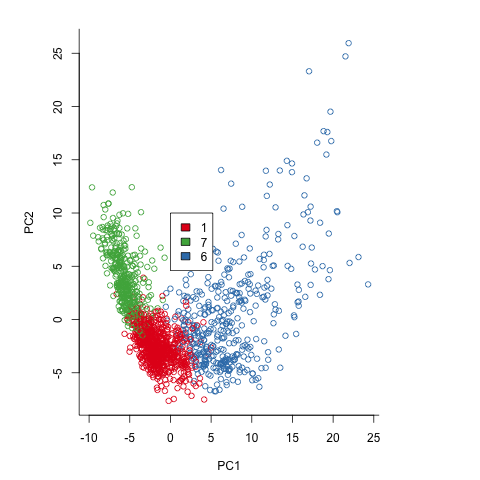

In [771]:
%%R -i CD8_sub2 

#Plot 1
colour_map = brewer.pal(20,'Set1')
par(xpd=TRUE)
par(mar=c(4.5,5.5,2,7))
plot(reducedDims(CD8_sub2)$PCA[,1], reducedDims(CD8_sub2)$PCA[,2], col=colour_map[colData(CD8_sub2)$louvain_r0.5_T], bty='L', xlab='PC1', ylab='PC2')
legend(x=0, y=10, legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=colour_map[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])

print("1:")
CD8_sub_start <- slingshot(CD8_sub2, clusterLabels = 'louvain_r0.5_T', reducedDim = 'PCA', start.clus='7')
print(SlingshotDataSet(CD8_sub_start))

#print("")
#print("2:")
#CD8_sub_startend <- slingshot(CD8_sub, clusterLabels = 'louvain_r1_T', reducedDim = 'PCA', start.clus='Combo-CD8L Hsp', end.clus=c('Combo-CD8 Cytotixic', 'Combo-CD4 effector'))
#print(SlingshoCD8Set(CD8_sub_startend))

#print("")
#print("3:")
#CD8_sub_simple_startend <- slingshot(CD8_sub, clusterLabels = 'louvain_r1_T', reducedDim = 'PCA', start.clus='Combo-T naive', end.clus='Combo-CD8 exhausted')
#print(SlingshotDataSet(CD8_sub_simple_startend))

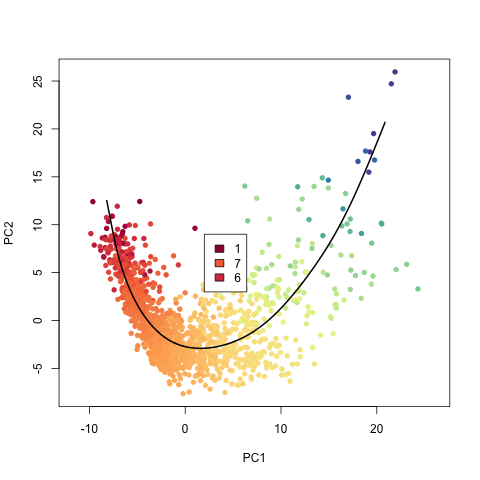

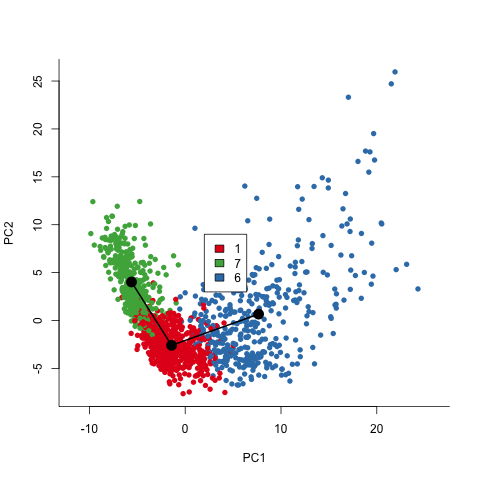

In [772]:
%%R

#Plot of lineage 1
colors <- colorRampPalette(brewer.pal(11,'Spectral')[-6])(100)
plot(reducedDims(CD8_sub_start)$PCA[,c(1,2)], col = colors[cut(CD8_sub_start$slingPseudotime_1,breaks=100)], pch=16, asp = 1, xlab='PC1', ylab='PC2')
lines(slingCurves(CD8_sub_start)$curve1, lwd=2)
legend(x=2,y=9,legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Spectral')[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])

#Plot of lineages with clusters visualized
par(xpd=TRUE)
plot(reducedDims(CD8_sub_start)$PCA[,c(1,2)], col = brewer.pal(11,'Set1')[CD8_sub2$louvain_r0.5_T], pch=16, asp = 1, bty='L', xlab='PC1', ylab='PC2')
lines(SlingshotDataSet(CD8_sub_start), lwd=2, type='lineages')
#legend(x=10, y=20, legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])
legend(x=2,y=9,legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])



[1] "1:"
class: SlingshotDataSet 

 Samples Dimensions
    3513         10

lineages: 2 
Lineage1: 3  9  0  4  8  
Lineage2: 3  9  2  5  

curves: 2 
Curve1: Length: 43.358	Samples: 2403.15
Curve2: Length: 52.793	Samples: 2318.16
[1] ""
[1] "2:"
class: SlingshotDataSet 

 Samples Dimensions
    3513         10

lineages: 2 
Lineage1: 3  9  0  4  8  5  
Lineage2: 3  9  2  

curves: 2 
Curve1: Length: 44.366	Samples: 2815.08
Curve2: Length: 50.892	Samples: 2053.08


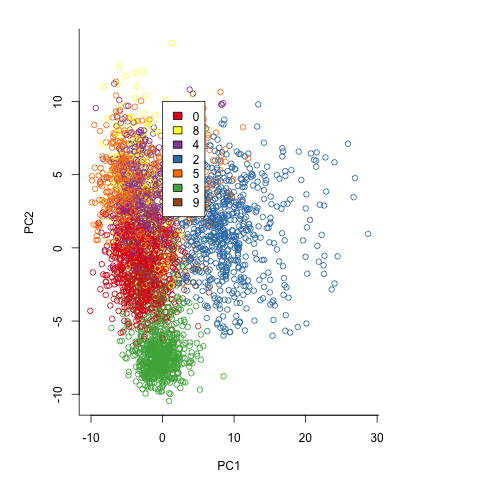

In [773]:
%%R -i CD4_sub2 

#Plot 1
colour_map = brewer.pal(20,'Set1')
par(xpd=TRUE)
par(mar=c(4.5,5.5,2,7))
plot(reducedDims(CD4_sub2)$PCA[,1], reducedDims(CD4_sub2)$PCA[,2], col=colour_map[colData(CD4_sub2)$louvain_r0.5_T], bty='L', xlab='PC1', ylab='PC2')
legend(x=0, y=10, legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=colour_map[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])

print("1:")
CD4_sub_start <- slingshot(CD4_sub2, clusterLabels = 'louvain_r0.5_T', reducedDim = 'PCA', start.clus='3')
print(SlingshotDataSet(CD4_sub_start))

print("")
print("2:")
CD4_sub_startend <- slingshot(CD4_sub2, clusterLabels = 'louvain_r0.5_T', reducedDim = 'PCA', start.clus='3', end.clus=c('5','2'))
print(SlingshotDataSet(CD4_sub_startend))

#print("")
#print("3:")
#CD8_sub_simple_startend <- slingshot(CD8_sub, clusterLabels = 'louvain_r1_T', reducedDim = 'PCA', start.clus='Combo-T naive', end.clus='Combo-CD8 exhausted')
#print(SlingshotDataSet(CD8_sub_simple_startend))

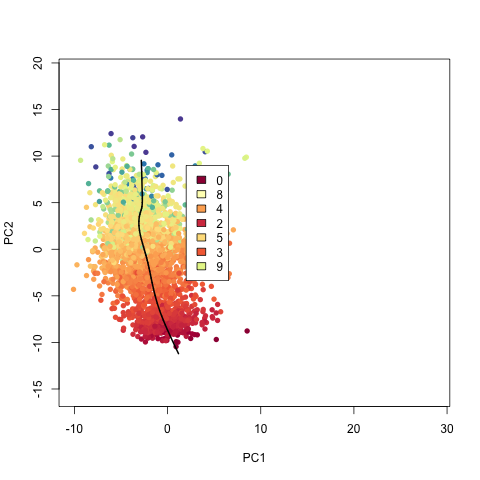

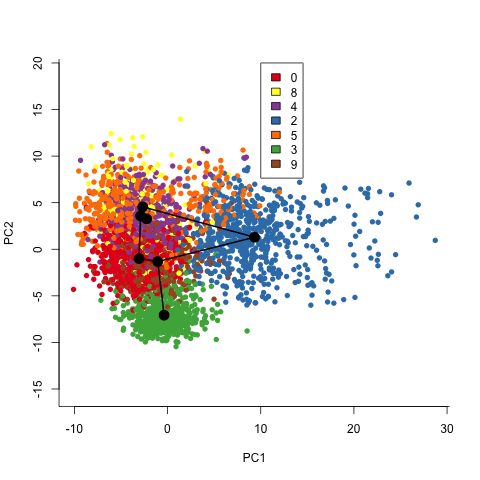

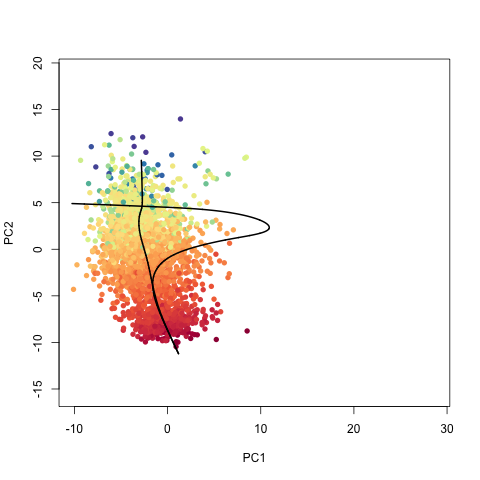

In [774]:
%%R

#Plot of lineage 1
colors <- colorRampPalette(brewer.pal(11,'Spectral')[-6])(100)
plot(reducedDims(CD4_sub_start)$PCA[,c(1,2)], col = colors[cut(CD4_sub_start$slingPseudotime_1,breaks=100)], pch=16, asp = 1, xlab='PC1', ylab='PC2')
lines(slingCurves(CD4_sub_start)$curve1, lwd=2)
legend(x=2,y=9,legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Spectral')[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])

#Plot of lineages with clusters visualized
par(xpd=TRUE)
plot(reducedDims(CD4_sub_start)$PCA[,c(1,2)], col = brewer.pal(11,'Set1')[CD4_sub2$louvain_r0.5_T], pch=16, asp = 1, bty='L', xlab='PC1', ylab='PC2')
lines(SlingshotDataSet(CD4_sub_start), lwd=2, type='lineages')
#legend(x=10, y=20, legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])
legend(x=10,y=20,legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])


#Plot of simpler clustering
plot(reducedDims(CD4_sub_start)$PCA[,c(1,2)], col = colors[cut(CD4_sub_start$slingPseudotime_1,breaks=100)], pch=16, asp = 1, xlab='PC1', ylab='PC2')
lines(SlingshotDataSet(CD4_sub_start), lwd=2)


# Diffusion Pseudotime (DPT)

In [775]:
sc.pp.neighbors(CD4_sub)
sc.tl.diffmap(CD4_sub)

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9855747  0.9801058  0.9784022  0.9601479  0.9381901
     0.9359688  0.93223864 0.91818315 0.91228974 0.9102585  0.90842897
     0.89603484 0.8919684  0.88794845]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


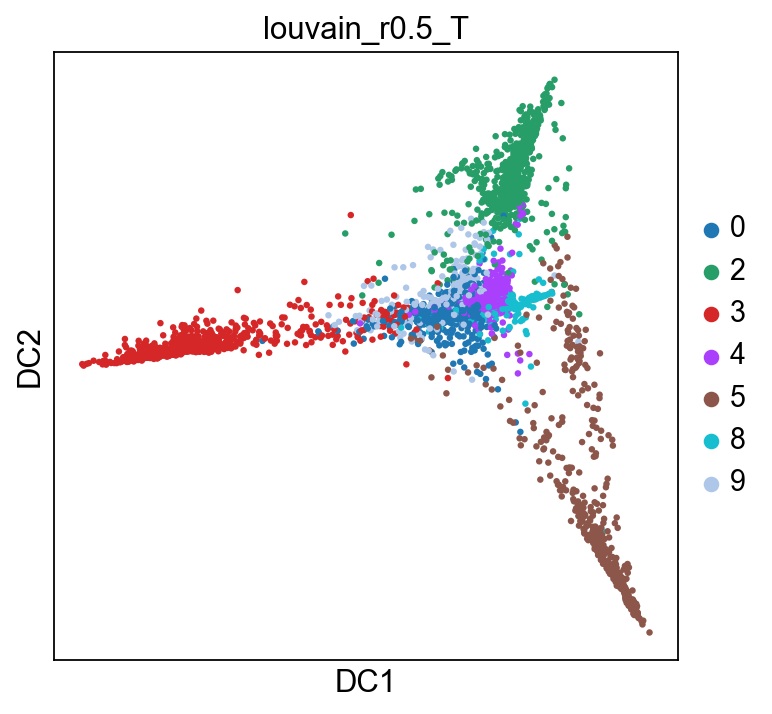

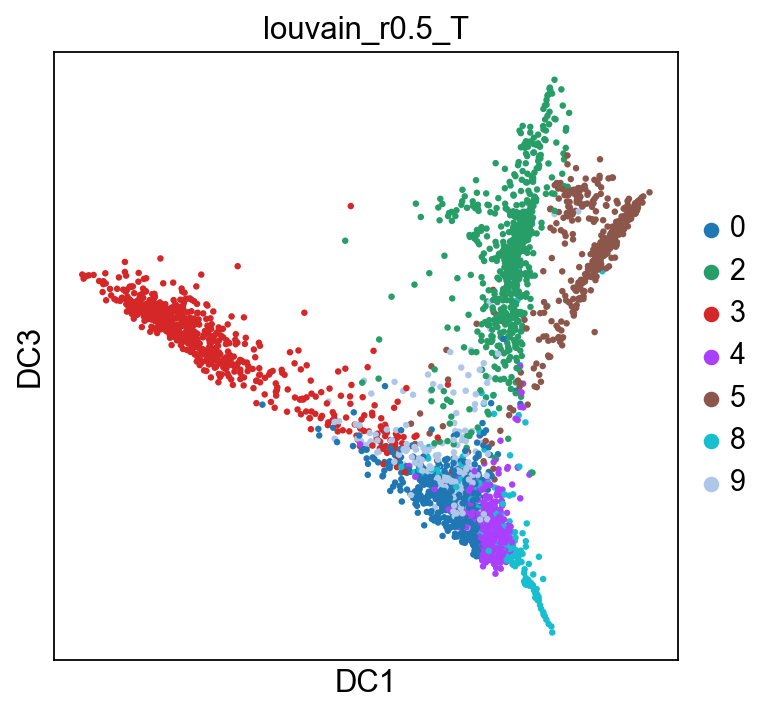

In [776]:
sc.pl.diffmap(CD4_sub, components='1,2', color='louvain_r0.5_T')
sc.pl.diffmap(CD4_sub, components='1,3', color='louvain_r0.5_T')

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


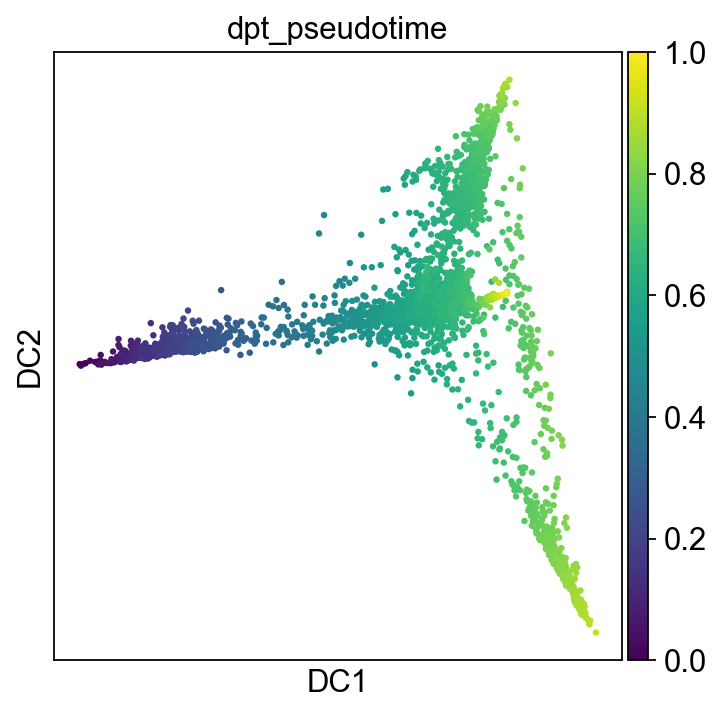

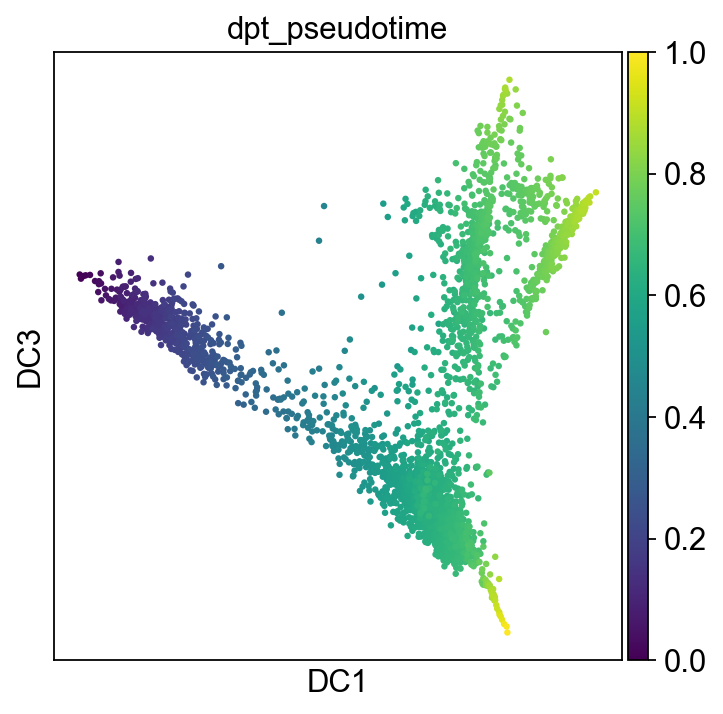

In [777]:
#Find the stem cell with the highest DC3 value to act as root for the diffusion pseudotime and compute DPT
stem_mask = np.isin(CD4_sub.obs['louvain_r0.5_T'], '3')
max_stem_id = np.argmin(CD4_sub.obsm['X_diffmap'][stem_mask,1]) #min of DC1
root_id = np.arange(len(stem_mask))[stem_mask][max_stem_id]
CD4_sub.uns['iroot'] = root_id

#Compute dpt
sc.tl.dpt(CD4_sub)

#Visualize pseudotime over differentiation
sc.pl.diffmap(CD4_sub, components='1,2', color='dpt_pseudotime')
sc.pl.diffmap(CD4_sub, components='1,3', color='dpt_pseudotime')

In [778]:
sc.tl.draw_graph(adata)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fr', graph_drawing coordinates (adata.obsm) (0:03:58)
